# 개발 환경 세팅

In [ ]:
!pip install koreanize_matplotlib

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import warnings
import matplotlib.ticker as ticker
import statsmodels.api as sm
import folium
import koreanize_matplotlib

from folium.plugins import HeatMap
from scipy.stats import stats, f_oneway, pearsonr, ttest_ind
from matplotlib.gridspec import GridSpec
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score



# ✅ Seaborn 테마 설정
sns.set_theme(
    style='white',  # 배경 스타일 ('darkgrid', 'whitegrid', 'dark', 'white', 'ticks' 가능)
    rc={
        'axes.unicode_minus': False,  # 마이너스 기호 깨짐 방지
        'figure.figsize': (12, 6),    # 기본 그래프 크기 설정
        'axes.labelsize': 14,         # 축 레이블 크기
        'xtick.labelsize': 12,        # x축 눈금 크기
        'ytick.labelsize': 12,        # y축 눈금 크기
        'legend.fontsize': 12,        # 범례 폰트 크기
        'axes.titleweight': 'bold',   # 제목 굵게 표시
        'axes.titlesize': 16          # 제목 크기 설정
    }
)

# ✅ Jupyter Notebook 그래프 선명하게 출력
%config InlineBackend.figure_format = 'retina'

# ✅ Pandas 출력 설정 (데이터프레임 가독성 향상)
pd.set_option("display.max_columns", None)  # 모든 컬럼 출력
pd.set_option('display.float_format', '{:.5f}'.format)  # 소수점 5자리까지 표시

# ✅ 경고 메시지 무시 (불필요한 Warning 제거)
warnings.filterwarnings("ignore")

# ✅ Jupyter에서 외부 모듈 변경 사항 자동 반영
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 프로젝트 주제 및 문제 제기

- 지하철, 버스를 이용할때 느낀 불편의성에 대하여
- 그에 맞는 대체 교통수단으로써 공용자전거(따릉이)를 이용할 수 있을까에 대한 고민에서 출발

- 여러가지 요인에 따른 서울시 대중교통 이용 경향성을 분석하고 그에 대한 대응책을 추론해 보자

# 요인 별 분석 과정

## 기상상황 - 유정원

- 비가 올때, 그리고 강수량에 따라, 눈이 올때, 그리고 적설량에 따른 대중교통 이용의 경향성을 파악하고
- 계절별, 월별, 평균온도에 따른 대중교통 이용경향성까지 분석

- 태블로 시각화 링크:
- https://public.tableau.com/views/_17400261331950/1?:language=ko-KR&:sid=&:redirect=auth&:display_count=n&:origin=viz_share_link

### 파일 불러오기

In [ ]:
# 일별_기상상황별_대중교통이용수.csv
# 월별_계절별_대중교통총승객수.csv
#위 두 파일 이용
data_path1 = '/content/일별_기상상황별_대중교통이용수.csv'
data_path2 = '/content/월별_계절별_대중교통총승객수.csv'
daily_merged = pd.read_csv(data_path1,encoding='utf-8')
monthly_merged = pd.read_csv(data_path2, encoding='utf-8')

### 날씨에 따른 대중교통 이용량 비교

#### 맑은날, 강수량이 있는날, 적설량이 있는날의 대중교통 이용자수의 평균계산 및 비교

In [ ]:
# 맑은날 평균계산
clear_day = daily_merged[
    (daily_merged['일강수량(mm)']==0)&(daily_merged['일 최심적설(cm)']==0)]
clear_day[
    ['버스승차총승객수','지하철승차총승객수','따릉이총대여건수']
    ].mean().round(1)

,0
버스승차총승객수,4615976.70000
지하철승차총승객수,7008787.40000
따릉이총대여건수,134778.00000


In [ ]:
# 강우량이 있는 날의 평균계산
rainy_day = daily_merged[
    (daily_merged['일강수량(mm)']>0)]
rainy_day[
    ['버스승차총승객수','지하철승차총승객수','따릉이총대여건수']
    ].mean().round(1)

,0
버스승차총승객수,4473480.6
지하철승차총승객수,6736292.1
따릉이총대여건수,91101.6


In [ ]:
# 강설량이 있는 날의 평균계산
snowy_day = daily_merged[
    (daily_merged['일 최심적설(cm)']>0)]
snowy_day[
    ['버스승차총승객수','지하철승차총승객수','따릉이총대여건수']
    ].mean().round(1)

,0
버스승차총승객수,4413251.5
지하철승차총승객수,6822254.0
따릉이총대여건수,51833.0


#### 강수량, 적설량, 버스/지하철/따릉이이용수의 서로의 상관계수 계산

In [ ]:
corr_weather = daily_merged[
    ['일강수량(mm)','일 최심적설(cm)','버스승차총승객수','지하철승차총승객수','따릉이총대여건수']
    ].corr()
corr_weather

,일강수량(mm),일 최심적설(cm),버스승차총승객수,지하철승차총승객수,따릉이총대여건수
일강수량(mm),1.000000,0.037501,-0.024135,-0.060422,-0.320459
일 최심적설(cm),0.037501,1.000000,0.049971,0.054263,-0.277801
버스승차총승객수,-0.024135,0.049971,1.000000,0.968472,0.451117
지하철승차총승객수,-0.060422,0.054263,0.968472,1.000000,0.413382
따릉이총대여건수,-0.320459,-0.277801,0.451117,0.413382,1.000000


#### 지하철/버스 이용객수에 영향을 미칠가능성이 있는 각 요소들에 대한 OLS 회귀분석

In [ ]:
# 버스이용승객과 요일, 강수량, 적설량, 기온과의 회귀분석실행
X1 = daily_merged[['요일','일강수량(mm)','일 최심적설(cm)','평균기온(°C)']]
Y1 = daily_merged['버스승차총승객수']
X1 = sm.add_constant(X1)
model1 = sm.OLS(Y1,X1).fit()

In [ ]:
print(model1.summary())

                            OLS Regression Results                            
Dep. Variable:               버스승차총승객수   R-squared:                       0.365
Model:                            OLS   Adj. R-squared:                  0.358
Method:                 Least Squares   F-statistic:                     51.94
Date:                Wed, 19 Feb 2025   Prob (F-statistic):           1.55e-34
Time:                        02:50:00   Log-Likelihood:                -5465.3
No. Observations:                 366   AIC:                         1.094e+04
Df Residuals:                     361   BIC:                         1.096e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       5.187e+06   9.05e+04     57.299      0.0

- 결과 해석
- R-squared(결정계수) : 0.365(모델이 전체데이터변동성의 36.5%를 설명)(63.5%의 변동성은 다른 요인일 가능성이 있음)

- Prob(F-statistic) = 1.55e-34(0.05보다 매우작음, 유의미함)

- 개별변수

- 요일별(유의미함)
    - p값 : 0(유의미함)
    - 계수(coef) : -2.732, 요일이 1 증가할수록(월요일에서 일요일이 될수록) 버스 승객수가 평균 273,200명 감소
- 일 강수량(유의미하지않음)
    - p값 : 0.2~(유의미하지않음)
- 일 최심적설량(유의미함)
    - p값: 0.03(유의미함)
    - 계수(coef) : 3.869e+04, 적설량이 1cm씩 증가할수록 버스 승객수가 약 38,690명 증가
    
- 평균기온(유의미함)
    - p값 : 0.001(유의미함)
    - 계수(coef) : 1.245e+04, 기온이 1도씩 증가할수록 버스승객수가 12,456명 증가

In [ ]:
# 지하철이용승객과 요일, 강수량, 적설량, 기온과의 회귀분석실행
X2 = daily_merged[['요일','일강수량(mm)','일 최심적설(cm)','평균기온(°C)']]
Y2 = daily_merged['지하철승차총승객수']
X2 = sm.add_constant(X2)
model2 = sm.OLS(Y2,X2).fit()

In [ ]:
print(model2.summary())

                            OLS Regression Results                            
Dep. Variable:              지하철승차총승객수   R-squared:                       0.331
Model:                            OLS   Adj. R-squared:                  0.324
Method:                 Least Squares   F-statistic:                     44.64
Date:                Wed, 19 Feb 2025   Prob (F-statistic):           1.91e-30
Time:                        04:15:10   Log-Likelihood:                -5641.6
No. Observations:                 366   AIC:                         1.129e+04
Df Residuals:                     361   BIC:                         1.131e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       8.137e+06   1.47e+05     55.518      0.0

- R-squared(결정계수) : 0.331(모델이 전체데이터변동성의 33.1%를 설명)(66.9%의 변동성은 다른 요인일 가능성이 있음)

- Prob(F-statistic) = 1.55e-34(0.05보다 매우작음, 유의미함)

- 개별변수

- 요일별(유의미함)
    - p값 : 0(유의미함)
    - 계수(coef) : -4.16e+05, 요일이 1 증가할수록(월요일에서 일요일이 될수록) 지하철 승객수가 평균 416,000명 감소
- 일 강수량(유의미하지않음)
    - p값 : 0.139(유의미하지않음)
    
- 일 최심적설량(유의미하지않음)
    - p값: 0.134(유의미하지않음)

- 평균기온(유의미하지않음)
    - p값 : 0.805(유의미하지않음)

#### 비여부, 눈여부 추가 컬럼 생성후 t검정 실행

In [ ]:
#일강수량이 5mm이상인 날, 그렇지 않은날로 나누어 t검정 실행
# 강우량이 5mm 이상이면 1(비 옴), 그이하면 0(맑음)
daily_merged['비여부'] = (daily_merged['일강수량(mm)'] >= 5).astype(int)
daily_merged['일강수량(mm)'].unique()

array([0.000e+00, 6.000e-01, 2.400e+00, 1.600e+00, 3.100e+00, 9.700e+00,
       5.000e-01, 4.000e-01, 2.000e-01, 3.900e+00, 1.090e+01, 1.710e+01,
       8.900e+00, 2.600e+00, 1.780e+01, 8.800e+00, 2.300e+00, 1.800e+00,
       2.100e+00, 1.000e-01, 5.400e+00, 5.100e+00, 1.150e+01, 1.900e+00,
       1.400e+00, 4.800e+00, 9.000e+00, 4.830e+01, 1.230e+01, 3.170e+01,
       2.060e+01, 8.700e+00, 1.000e+00, 8.000e-01, 1.690e+01, 6.100e+00,
       1.650e+01, 3.830e+01, 3.220e+01, 6.510e+01, 3.600e+00, 4.100e+00,
       2.800e+00, 2.870e+01, 2.110e+01, 3.000e-01, 1.700e+01, 9.880e+01,
       1.288e+02, 1.490e+01, 8.500e+00, 7.990e+01, 2.000e+00, 1.470e+01,
       2.530e+01, 5.500e+00, 3.350e+01, 1.300e+00, 3.400e+00, 3.000e+00,
       6.400e+00, 1.100e+01, 4.220e+01, 2.700e+00, 6.900e+00, 7.000e-01,
       3.270e+01, 7.600e+00, 9.500e+00, 5.450e+01, 2.700e+01, 1.200e+00,
       2.500e+00, 4.710e+01, 6.500e+00, 2.600e+01, 2.240e+01, 4.900e+00,
       2.900e+00])

In [ ]:
#일 최심적심이 3cm이상인 날, 그렇지 않은 날로 나누어 t검정 실행
#일최심적심이 3cm 이상이면 1(눈 옴), 그이하면이면 0(눈안옴)
daily_merged['눈여부'] = (daily_merged['일 최심적설(cm)'] >= 3).astype(int)
daily_merged['일 최심적설(cm)'].unique()

array([ 2.4,  0. ,  6. ,  5.6,  1.5,  3.1,  3. ,  2. ,  2.3,  1.1,  3.6,
        3.8,  5.2, 13.8, 10.2,  0.2,  0.9, 20.1, 28.6, 12.3,  7.9,  5.3,
        0.5,  2.7,  1.4,  0.7])

In [ ]:
from scipy.stats import ttest_ind

no_rain_bus = daily_merged[(daily_merged['일강수량(mm)'] == 0)&(daily_merged['일 최심적설(cm)'] == 0)]['버스승차총승객수']

rain_bus = daily_merged[daily_merged['일강수량(mm)'] >= 5]['버스승차총승객수']

t_stat, p_val = ttest_ind(no_rain_bus, rain_bus, equal_var=False)

print(f"버스승객수와 강수량: T-statistic: {t_stat:.4f}, P-value: {p_val:.4f}")


버스승객수와 강수량: T-statistic: 1.9108, P-value: 0.0604


In [ ]:
no_rain_subway = daily_merged[(daily_merged['일강수량(mm)'] == 0)&(daily_merged['일 최심적설(cm)'] == 0)]['지하철승차총승객수']

rain_subway = daily_merged[daily_merged['일강수량(mm)'] >= 5]['지하철승차총승객수']

t_stat, p_val = ttest_ind(no_rain_subway, rain_subway, equal_var=False)

print(f"지하철승객수와 강수량: T-statistic: {t_stat:.4f}, P-value: {p_val:.4f}")

지하철승객수와 강수량: T-statistic: 2.4993, P-value: 0.0149


In [ ]:
no_snow_bus = daily_merged[(daily_merged['일강수량(mm)'] == 0)&(daily_merged['일 최심적설(cm)'] == 0)]['버스승차총승객수']

snow_bus = daily_merged[daily_merged['일 최심적설(cm)'] >= 3]['버스승차총승객수']

t_stat, p_val = ttest_ind(no_snow_bus, snow_bus, equal_var=False)

print(f"버스승객수와 강설량: T-statistic: {t_stat:.4f}, P-value: {p_val:.4f}")

버스승객수와 강설량: T-statistic: 0.2013, P-value: 0.8432


In [ ]:
no_snow_subway = daily_merged[(daily_merged['일강수량(mm)'] == 0)&(daily_merged['일 최심적설(cm)'] == 0)]['지하철승차총승객수']

snow_subway = daily_merged[daily_merged['일 최심적설(cm)'] >= 3]['지하철승차총승객수']

t_stat, p_val = ttest_ind(no_snow_subway, snow_subway, equal_var=False)

print(f"지하철승객수와 강설량: T-statistic: {t_stat:.4f}, P-value: {p_val:.4f}")

지하철승객수와 강설량: T-statistic: -0.0037, P-value: 0.9971


#### 비여부, 눈여부 와 지하철, 버스 이용자 수의 상관계수와 p값 계산

In [ ]:
corr, p_value = stats.pearsonr(daily_merged['비여부'], daily_merged['지하철승차총승객수'])

print(f"지하철 강수량: Pearson 상관계수: {corr:.4f}")
print(f"P-value: {p_value:.4f}")

지하철 강수량: Pearson 상관계수: -0.1303
P-value: 0.0126


In [ ]:
corr, p_value = stats.pearsonr(daily_merged['비여부'], daily_merged['버스승차총승객수'])

print(f"버스 강수량: Pearson 상관계수: {corr:.4f}")
print(f"P-value: {p_value:.4f}")

버스 강수량: Pearson 상관계수: -0.0977
P-value: 0.0619


In [ ]:
corr, p_value = stats.pearsonr(daily_merged['눈여부'], daily_merged['지하철승차총승객수'])

print(f"지하철 강설량: Pearson 상관계수: {corr:.4f}")
print(f"P-value: {p_value:.4f}")

지하철 강설량: Pearson 상관계수: 0.0140
P-value: 0.7898


In [ ]:
corr, p_value = stats.pearsonr(daily_merged['눈여부'], daily_merged['버스승차총승객수'])

print(f"버스 강설량: Pearson 상관계수: {corr:.4f}")
print(f"P-value: {p_value:.4f}")

버스 강설량: Pearson 상관계수: 0.0014
P-value: 0.9793


- 지하철과 5mm이상의 강수량(비여부:1) 과의 상관계수와 p값

    - p-값 : 0.0126
    - 상관계수 : -0.1303
    - *통계적으로 유의미한 약한 음의 상관관계가 있다.*
    - 즉 비가 많이 올수록 지하철 이용이 줄어드는 경향은 있지만 체감할정도라고 보기에는 어렵다

- 지하철과 3cm이상의 강설량(눈여부:1)과의 상관계수와 p값

    - p-값: 0.7898
    - 상관계수: 0.0140
    - *통계적으로 유의미하지 않다*

- 버스와 5mm이상의 강수량과의 상관계수와 p값

    - p-값 : 0.0619
    - 상관계수 : 0.0619
    - *통계적으로 유의미하지 않다*

- 버스와 3cm이상의 강설량과의 상관계수와 p값

    - p-값: 0.9794
    - 상관계수: 0.0014
    - *유의미하지 않다*

#### 시각화

![](https://drive.google.com/uc?export=view&id=1H4Jx9OrJJdoG3MBQEDCUUO3nbBSqTsZv)

### 계절과 평균온도에 따른 대중교통 이용량 비교

#### 각 대중교통과 월,계절,평균기온에따른 상관계수와 p값 계산

In [ ]:
results = []

season_vars = ['월숫자','계절숫자','평균기온(°C)']
transport_vars = ['버스승차총승객수','지하철승차총승객수']

for var in season_vars:
    for t_var in transport_vars:
        corr, p_val = pearsonr(monthly_merged[var],monthly_merged[t_var])
        results.append({
            '변수':var,
            '대중교통':t_var,
            '상관계수':round(corr,4),
            'p값':round(p_val,4)
        })

results_corr_p = pd.DataFrame(results)
print(results_corr_p)

         변수       대중교통     상관계수      p값
0       월숫자   버스승차총승객수  0.69990 0.01130
1       월숫자  지하철승차총승객수  0.29720 0.34820
2      계절숫자   버스승차총승객수 -0.42810 0.16500
3      계절숫자  지하철승차총승객수 -0.47720 0.11670
4  평균기온(°C)   버스승차총승객수  0.43960 0.15280
5  평균기온(°C)  지하철승차총승객수 -0.08000 0.80480


- 월숫자/버스승차총승객수: 강한 양의 상관관계를 보이며 p값도 유의미하다
- 1월에서 12월이 될수록 버스 승차객수가 증가하는 경향을 보인다
- 그 외 데이터는 유의미하다고 보기 어렵다

####시각화

![](https://drive.google.com/uc?export=view&id=14PysAgNz-c_a68e-wOdHQNZJKuPlfUlO)

### 자전거 이용패턴 분석

#### 파일 불러오기

In [ ]:
 bike_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/따릉이_일별_이용정보(2024년).csv", parse_dates=['대여일자'])

#### 시각화

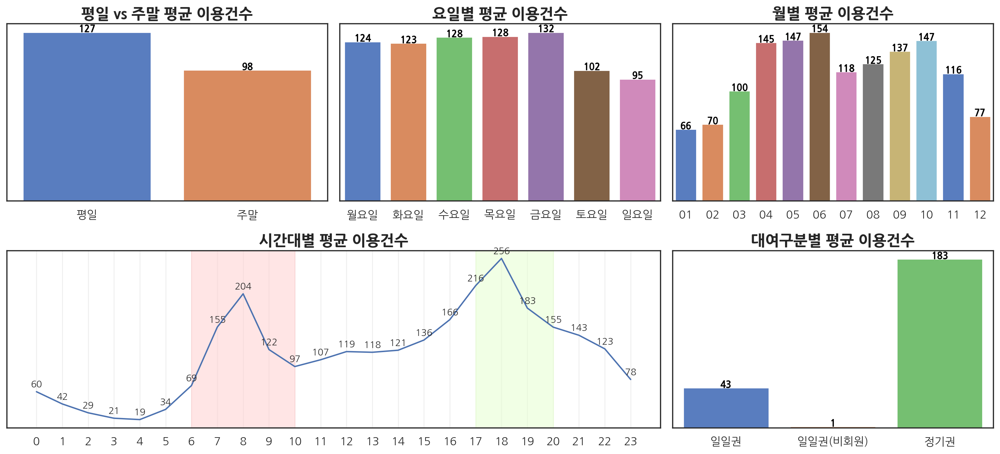

In [ ]:
fig = plt.figure(figsize=(15, 10))
gs = GridSpec(6, 6, figure=fig)

# ax1: 평일 vs 주말 이용 건수
ax1 = fig.add_subplot(gs[0:2, 0:2])
sns.barplot(data=bike_df, x='구분', y='이용건수', errorbar=None, ax=ax1, palette='muted')

ax1.set_title("평일 vs 주말 평균 이용건수")

# ax2: 요일별 이용건수
ax2 = fig.add_subplot(gs[0:2, 2:4])
sns.barplot(data=bike_df, x='요일', y='이용건수', errorbar=None, ax=ax2, palette='muted')
ax2.set_title("요일별 평균 이용건수")

# ax3: 월별 이용건수
month_group = bike_df.groupby('대여일자')['이용건수'].mean().reset_index()  # 일별 이용건수 그룹화
month_group['대여월'] = pd.to_datetime(month_group['대여일자']).dt.strftime("%m")  # 연월 컬럼 추가

ax3 = fig.add_subplot(gs[0:2, 4:6])
sns.barplot(data=month_group, x='대여월', y='이용건수', errorbar=None, palette='muted')
ax3.set_title("월별 평균 이용건수")

# ax4: 시간대별 이용시간
time_group = bike_df.groupby('대여시간')['이용건수'].mean().round(0).astype(int).sort_index().reset_index()
ax4 = fig.add_subplot(gs[2:4, 0:4])
sns.lineplot(data=time_group, x='대여시간', y='이용건수', errorbar=None, palette="muted")
for i in range(len(time_group)):
    ax4.annotate(str(time_group['이용건수'][i]),
                (time_group['대여시간'][i], time_group['이용건수'][i]),
                textcoords="offset points", xytext=(0,5), ha='center', fontsize=10)
ax4.set_xticks(np.arange(0, 24, 1))
ax4.axvspan(6, 10, color='#FFCCCC', alpha=0.5)
ax4.axvspan(17, 20, color='#E5FFCC', alpha=0.5)
ax4.grid(alpha=0.3)
ax4.set_title("시간대별 평균 이용건수")

# ax5: 대여구분별 평균 이용건수
ax5 = fig.add_subplot(gs[2:4, 4:6])
sns.barplot(data=bike_df, x='대여구분코드', y='이용건수', errorbar=None, palette="muted")
ax5.set_title("대여구분별 평균 이용건수")

# 박스 플롯에 수치 추가
for ax in [ax1, ax2, ax3, ax5]:
    bars = ax.patches

    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2, height + 0.5, f"{height:.0f}",
                ha='center', fontsize=10, fontweight='bold', color='black')

# 중복되는 항목 순환
for ax in [ax1, ax2, ax3, ax4, ax5]:
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_yticks([])


plt.rc('font', family='Nanum Gothic')
plt.tight_layout()
plt.show()

#### 자전거 데이터와 날씨 데이터 병합

In [ ]:
day_group = bike_df.groupby('대여일자')['이용건수'].mean().round(0).astype(int).reset_index()  # 대여일자, 평균 이용건수 그룹화
weather_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/일평균_강수량_기온(2024년).csv")  # 강수량, 기온관련 데이터 불러오기
weather_df['날짜'] = pd.to_datetime(weather_df['날짜'])  # 날짜타입으로 변경
weather_df.rename(columns={'날짜':'대여일자'}, inplace=True)  # 컬럼명 통일화를 위한 수정
weather_group = pd.merge(day_group, weather_df, on='대여일자', how='left')  # 데이터셋 병합

#### 시각화

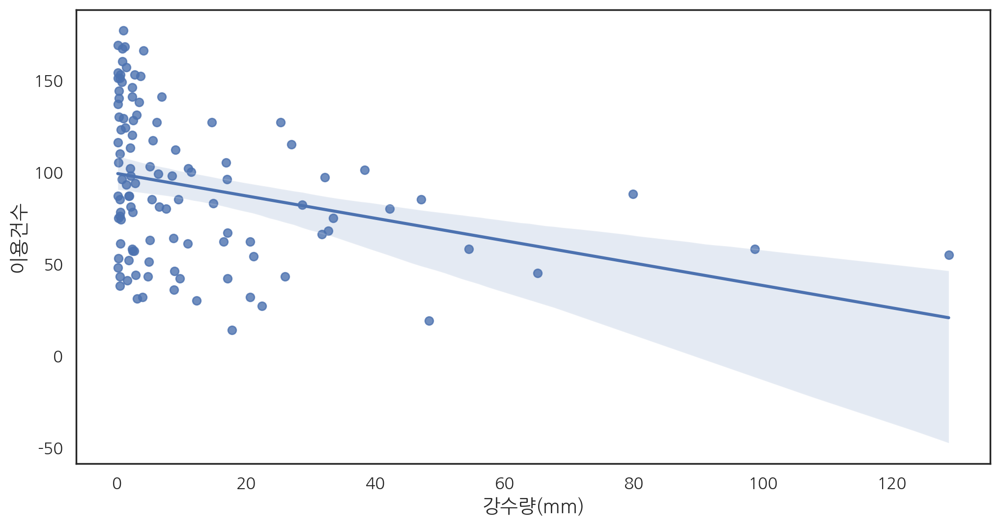

In [ ]:
# 강수량과 이용건수의 상관관계
sns.regplot(data=weather_group[weather_group['강수량(mm)'] > 0], x='강수량(mm)', y='이용건수')

plt.rc('font', family='NanumGothic')
plt.show()

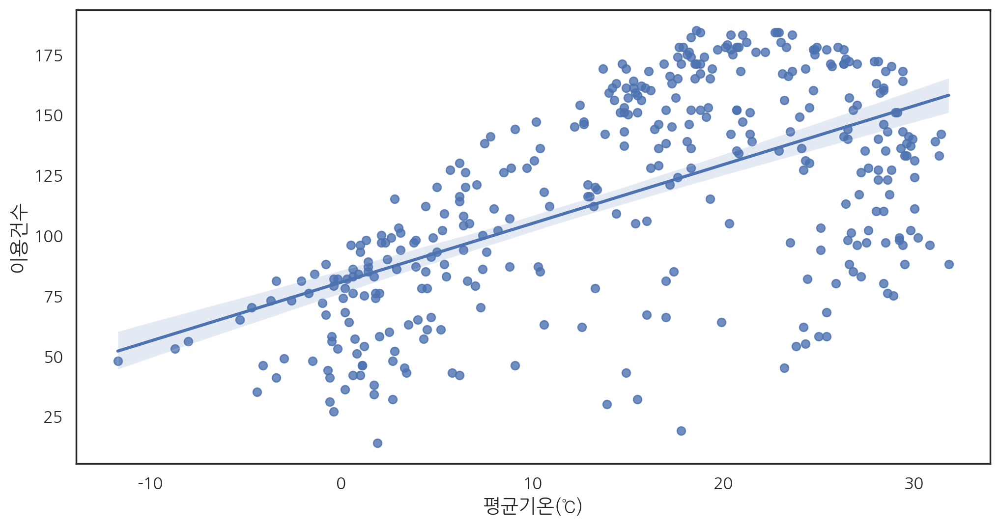

In [ ]:
# 평균기온과 이용건수의 상관관계
sns.regplot(data=weather_group, x='평균기온(℃)', y='이용건수')

plt.rc('font', family='NanumGothic')
plt.show()

#### 가설검정

##### `가설1`: 출퇴근시간의 자전거 이용량이 아닌시간에 비해 높을 것이다

In [ ]:
# 시간-이용건수 데이터 그룹화
work_data = bike_df.groupby('대여시간')['이용건수'].sum().reset_index()

# 출퇴근시간과 아닌시간 분리
rush_time = work_data[((work_data['대여시간'] >= 7) & (work_data['대여시간'] <=10)) | ((work_data['대여시간'] >= 17) & (work_data['대여시간'] <= 22))]['이용건수']
nomal_time = work_data[~((work_data['대여시간'] >= 7) & (work_data['대여시간'] <=10)) | ((work_data['대여시간'] >= 17) & (work_data['대여시간'] <= 22))]['이용건수']

# t-test 진행
t_stat, p_value = stats.ttest_ind(rush_time, nomal_time, equal_var=False)

# t_score, p_value 값 출력
print(f"t_score: {t_stat}\np_value: {p_value}")

t_score: 2.4350467255421986
p_value: 0.023082109737775674


##### `가설2`: 평일이 주말보다 자전거 이용량이 많을 것이다

In [ ]:
# 요일 수치화 및 이용건수와 그룹화
bike_df['요일번호'] = bike_df['대여일자'].dt.dayofweek
week_data = bike_df.groupby('요일번호')['이용건수'].sum().reset_index()

# 평일-주말 구분
weekday = week_data.query('요일번호 <= 4')
holiday = week_data.query('요일번호 > 4')

# t-test 진행
t_stat, p_value = stats.ttest_ind(weekday['이용건수'], holiday['이용건수'], equal_var=False)

# t_score, p_value 값 출력
print(f"t_score: {t_stat}\np_value: {p_value}")

t_score: 7.166853957007134
p_value: 0.051898068556299505


##### `가설3`: 계절에 따른 이용량 차이가 있을 것이다

In [ ]:
# 문자형식 월 컬럼 생성
bike_df['월'] = pd.to_datetime(bike_df['대여일자']).dt.strftime("%b")

# 계절별로 그룹화
spring = bike_df.query('월 in ["Mar", "Apr", "May"]')['이용건수']
summer = bike_df.query('월 in ["Jun", "Jul", "Aug"]')['이용건수']
fall = bike_df.query('월 in ["Sep", "Oct", "Nov"]')['이용건수']
winter = bike_df.query('월 in ["Dec", "Jan", "Feb"]')['이용건수']

# ANOVA 테스트 진행
f_stat, p_value = f_oneway(spring, summer, fall, winter)

# f_score, p_value 값 출력
print(f"f_score: {f_stat}\np_value: {p_value}")

f_score: 1486.8156563080106
p_value: 0.0


##### `가설4`: 강수량과 평균기온이 자전거의 이용량에 영향을 미칠 것이다.

In [ ]:
# 이용건수 그룹화
rental_df = bike_df.groupby('대여일자')['이용건수'].sum().reset_index()

# 이용건수와 날씨 데이터 그룹화
rental_by_weather = pd.merge(rental_df, weather_df, on='대여일자', how='left')

# 평균기온과 이용건수의 상관분석
temp_corr, p_value = pearsonr(rental_by_weather['평균기온(℃)'], rental_by_weather['이용건수'])

# 강수량과 이용건수의 상관분석
rain_corr, p_value = pearsonr(rental_by_weather['강수량(mm)'], rental_by_weather['이용건수'])

# ANOVA
f_stat, p_value = f_oneway(rental_by_weather['강수량(mm)'], rental_by_weather['평균기온(℃)'], rental_by_weather['이용건수'])

print("평균기온과 이용건수의 상관분석 결과")
print(f"pearson_num: {temp_corr}\np_value: {p_value}")
print()

print("강수량과 이용건수의 상관분석 결과")
print(f"pearson_num: {rain_corr}\np_value: {p_value}")
print()

print("강수량, 평균기온과 이용건수 분석 결과")
print(f"f_score: {f_stat}\np_value: {p_value}")

평균기온과 이용건수의 상관분석 결과
pearson_num: 0.5989211817782768
p_value: 0.0

강수량과 이용건수의 상관분석 결과
pearson_num: -0.3167720104977277
p_value: 0.0

강수량, 평균기온과 이용건수 분석 결과
f_score: 2265.7446344947944
p_value: 0.0


### 분석결과 및 한계

- `기상상황`
- 월요일부터 일요일이 될수록 버스, 지하철과 따릉이 이용객은 감소한다
- 강수량이 증가할때 따릉이 이용수가 감소한다.
- 비가 5mm이상으로 많이 올 시 지하철 이용 승객이 감소하는 경향이 있지만 체감할정도라고 보기에는 어렵다
- 눈이 많이 올수록 버스 승객은 증가한다
- 눈이 많이 올수록 따릉이용객은 감소한다
- 온도가 높아질수록 버스와 따릉이 이용자수는 증가
- 월이 진행됨에 따라(1월에서 12월이 됨에따라) 버스이용자의 수가 증가하는 경향성을 보인다

- `자전거 이용패턴`
- 출퇴근시간대 이용량이 급증하여 출퇴근 이동과 연관이 있음
- 21시 이후 이용량에 따른 결과 야간시간대의 수요가 급격하게 낮음
- 평일(127건)이 주말(98건)보다 이용량이 많아 출퇴근 수단으로 활용 비중 가능성 있음
- 금요일(132건)이 가장 많고, 일요일(95건)이 가장 적으므로 영업일 이용 비중이 높음
- 5~6월(154건) 가장 많고, 1월(66건)과 12월(77건) 가장 적어 계절별 차이가 큼.
- 월별 이용량 변화로 보아 날씨와 연관되며, 겨울철 이용이 감소하고 봄·여름철 증가함.
- 정기권 이용자(183건)가 일일권(43건)보다 압도적으로 높음

- 한계
- OLS회귀분석 모델적합성에 대하여
- 잔차독립성과 잔차정규성에 오류가 있을 가능성이 있다.
- 잔차 간 상관관계가 있을가능성과 잔차(오차)의 분포가 정규성을 따르지 않을 가능성이있다
- 또한 눈이 온날(즉, 일 최심적설량이 존재하는 날)이 총 28일 밖에 존재하지 않으므로
- 적설량에대한 분석은 더 많은 데이터를 가지고 다시 실행할 필요가 있다.

## 사회적 요인 - 이동혁, 윤지수

### 1. 집회가 많이 열리는 지역

In [ ]:
# 집회 데이터 로드
prt_path = '/content/drive/MyDrive/코드잇_DA_6기/스프린트 프로젝트/집회_전처리완ver.csv'
protest = pd.read_csv(prt_path)
# 여러 관할서 중 해당되는 관할서를 모두 카운트
precint_cnt = protest['관할서'].value_counts()
precint_dict = {}


for idx in  precint_cnt.index:
    if '/' not in idx:
        precint_dict[idx] = [protest[protest['관할서'].str.contains(idx, na=False)]['관할서'].value_counts().sum()]

# 딕셔너리 -> 데이터 프레임 변환 및 정렬
precint_df = pd.DataFrame(precint_dict).T
precint_df.sort_values(by=0, ascending=False, inplace=True)

In [ ]:
# 집회가 자주 발생하는 지역의 상위 10개 관할서 출력
precint_df.head(10)

,0
종로,604
남대문,520
용산,275
구로,265
영등포,246
서초,132
중부,85
마포,66
서대문,49
강남,45


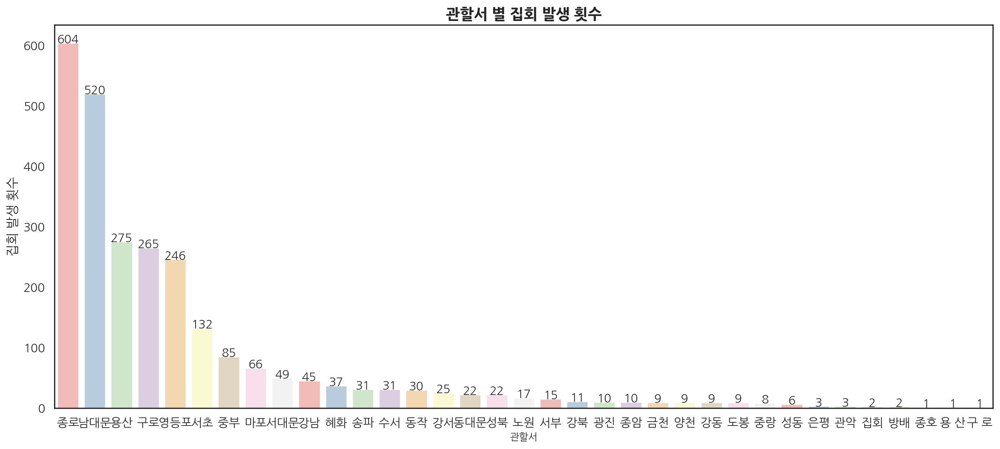

In [ ]:
# 한글 폰트 설치
#!apt-get -qq install -y fonts-nanum
#!fc-cache -fv
#!rm ~/.cache/matplotlib -rf

# 한글 폰트 적용
plt.rc('font', family='NanumGothic')
plt.rc('axes', unicode_minus=False)  # 마이너스 기호 깨짐 방지


# 관할서 별 집회 발생 횟수 시각화
fig, ax = plt.subplots(figsize=(17, 7))

sns.barplot(x=precint_df.index, y=precint_df[0], palette='Pastel1')
plt.title("관할서 별 집회 발생 횟수", size=15)
plt.xlabel("관할서", size=10)
plt.ylabel("집회 발생 횟수", size=13)

# 값 표시
for p in ax.patches:
    ax.text(p.get_x() + (p.get_width()/2) ,   # 가로 위치
            p.get_y() + p.get_height(),   # 세로 위치
            f"{p.get_height():.0f}",     # 값 + 표시방법 소수 둘째자리까지
            ha = 'center' )   # 좌우정렬 중간으로

plt.show()

- 종로(604건), 남대문(520건), 용산(275건), 구로(265건), 영등포(246건), 서초(132건) 순으로 집회가 많음을 확인할 수 있다.

### 2. 버스, 지하철, 집회 지도 시각화
- 🔗 [Tableau 1](https://public.tableau.com/app/profile/jisu.yun/viz/___17403892879050/1_1)
- 🔗 [Tableau 2](https://public.tableau.com/app/profile/woojin.choe5886/viz/414_17404562596510/sheet6)

### 분석결과 및 한계

## **지역 - 임영택**

- 행정동 별 유동인구 및 생활인구 분포에 따른 (통근자 및 관광객)교통 이용량 차이 분석
    - 목적: 지역 별 교통 정책 수립 및 출퇴근·관광객 대상 교통 서비스 개선

### **기본 개념**

#### 1. 생활인구의 정의
- 생활인구는 특정 지역에서 **실제로 활동 중인 인구**를 의미  
- 즉, 주민등록상 **해당 지역에 살지 않더라도**, 출퇴근, 관광, 쇼핑, 학업 등 다양한 이유로 해당 지역에 머무는 사람들을 포함한 인구

#### 2. 행정동의 정의
- 행정 효율성을 위해 설정된 **행정 구역 단위**
- 주민센터를 중심으로 행정 업무 수행 (주민등록, 복지, 민원 등)
- 인구 변화에 따라 조정 가능

### **데이터 전처리 (생활인구)**

[생활인구(내국인)](https://data.seoul.go.kr/dataList/OA-14991/S/1/datasetView.do) 👨‍👩‍👧‍👦 / [생활인구(외국인)](https://data.seoul.go.kr/dataList/OA-14992/S/1/datasetView.do) 👨‍👨‍👧‍👧 <= 링크 Click

| 생활인구(내국인) | 생활인구(외국인) |
|-------------|-------------|
| 기준일id(날짜) | 기준일id(날짜) |
| 시간대구분(시간) | 시간대구분(시간) |
| 행정동코드 | 행정동코드 |
| 성별 | 중국인 |
| 나이대별(5세 단위) | 중국인 외 외국인 |

**1일 1시간 단위의 데이터가 1달 단위의 파일(.csv)로 저장되어 있음**

#### **초기 데이터 전처리 (실패 多)**

In [ ]:
# 해당 경로 내 LOCAL_PEOPLE_DONG_라는 이름을 가진 csv파일을 하나로 병합
import pandas as pd
import glob

file_list = glob.glob("/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구(내)/LOCAL_PEOPLE_DONG_*.csv")

df_list = [pd.read_csv(file) for file in file_list]
merged_df = pd.concat(df_list, ignore_index=True)

merged_df.to_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구(내)/LOCAL_PEOPLE_DONG_ALL.csv", index=False)

- 무언가 잘못 되었음을 직감
    - 용량이 너무 커져버리니 colab의 RAM용량을 오버하여 작업이 취소됨

- colab을 이용해서 하는 것 보다 직접 하는게 나을 것 같다고 판단

- 원시적으로 로컬 파일(12개의 csv파일)을 하나하나 열어서 수정함
    - 용량이 커서 파일 열고 저장하는데도 꽤 오랜 시간 소요

    - 숫자데이터로 표현되어도 괜찮은 데이터들이 전부 문자열데이터로 저장되어 용량이 크다고 생각했음

```
csv파일 cmd로 합치는 법!

메모장에

copy *.csv (파일명).csv 입력

저장할때 확장자 .bat으로 저장
```

- 위의 방법으로 직접 문자열데이터를 숫자데이터로 수정한 파일을 하나로 합침

    - 생각보다 용량이 크게 차이나지 않음

    - 지금 생각해보니 웹 Tableau & 유니온이라는 시스템을 이해하지 못한 것 같음

    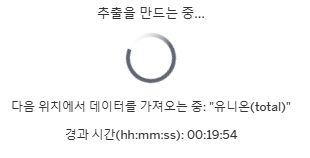

- 전처리 후에도 용량이 너무 커서(약 3GB) 데이터를 읽는데 어려움이 있다고 생각하여 한번 더 전처리를 하기로 함

- 필요없는 컬럼 삭제 (성별과 나이)

    - 용량이 확 줄었음! 👍 다만 여전히 시간은 오래걸렸음 😥

#### **Tableau 시각화**

- NULL값 발견

    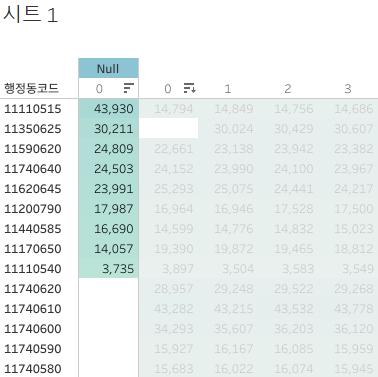

- tableau필터로 NULL의 위치를 찾아내어 메모

    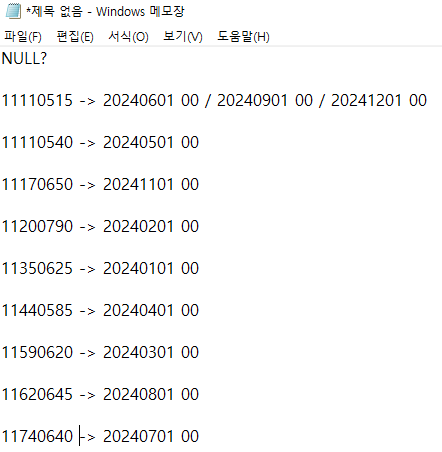

- 공통적으로 각 월의 00시 첫 데이터였음

- 메모장으로 합칠때 컬럼명을 다 지우려고 했는데 그게 NULL값으로 들어가게 된 것 같아서 다시 ROLLBACK

- 외국인의 데이터도 같은 컬럼만 남기고 합침

#### **생활인구 데이터**

 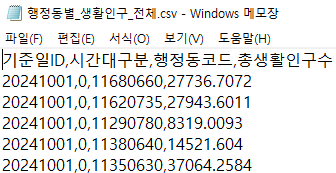

- 위의 행정동코드는 행장부행정동코드라서 생활인구의 데이터와 맞추기위해서는 통계청 행정동코드로 변환이 필요

- 이때부터는 colab을 이용해서 데이터 수정을 하게됨 (팀원에게 물어봄)

In [ ]:
# 드디어 merge와 drop을 사용할 수 있게 된 원시인...
import pandas as pd

csv_file_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구/행정동별_생활인구_전체.csv'
xlsx_file_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구/행정동코드.xlsx'

csv_df = pd.read_csv(csv_file_path, encoding="utf-8", dtype=str)
xlsx_df = pd.read_excel(xlsx_file_path, dtype={"행자부행정동코드": str})

merged_df = csv_df.merge(xlsx_df, left_on="행정동코드", right_on="행자부행정동코드", how="left")
merged_df.drop(columns=["행자부행정동코드"], inplace=True)
merged_df.drop(columns=["행정동코드"], inplace=True)
merged_df.rename(columns={"통계청행정동코드": "행정동코드"}, inplace=True)
merged_df.drop(columns=["시도명"], inplace=True)
merged_df.drop(columns=["시군구명"], inplace=True)

output_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구/행정동별_생활인구.csv"
merged_df.to_csv(output_path, index=False, encoding="utf-8")

### **데이터 전처리 (생활이동)**

#### **실패한 데이터셋**

[생활이동](https://data.seoul.go.kr/dataVisual/seoul/seoulLivingMigration.do) 🧍‍♂️ <= 링크 Click

| 생활이동 |
|----------|
| 대상연월 |
| 요일 |
| 도착시간 |
| 출발 행정동코드 |
| 도착 행정동코드 |
| 성별 |
| 나이 |
| 이동유형 |
| 평균 이동시간(분) |
| 이동인구(합계) |

1달의 1시간 단위의 데이터로 저장되어있음 (1년 = 12달 * 24시간 = 288개의 csv파일)

- 파일 하나하나의 용량이 매우 큼
    - 총 70GB

    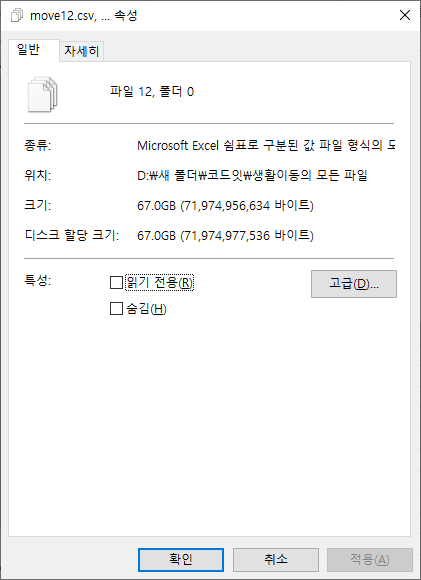

- 288개의 파일을 하나하나 수정할 수는 없으니까 1달 단위로 묶어서 데이터 전처리를 하려 했으나 1달치 데이터 용량이 6GB정도라서

- 파이썬을 이용하여 로컬파일을 바로 수정할 수 있게 함

In [ ]:
# 불필요한 컬럼을 지운다!
import pandas as pd
import glob
import os

# 1. 파일 경로 설정
input_directory = r'D:\새 폴더\코드잇\생활이동\원본파일\\'  # 원본 CSV 파일이 저장된 디렉토리 경로
output_directory = r'D:\새 폴더\코드잇\생활이동\수정파일\\'  # 수정된 파일을 저장할 디렉토리 경로

# 2. 제거할 불필요한 컬럼 정의
columns_to_remove = ['성별', '나이', '이동유형', '평균 이동 시간(분)']  # 제거할 컬럼명 리스트

# 3. 디렉토리 내 모든 CSV 파일 읽기 및 불필요한 컬럼 제거
all_files = glob.glob(os.path.join(input_directory, '*.csv'))  # 원본 디렉토리의 모든 CSV 파일 경로 가져오기

for filename in all_files:
    df = pd.read_csv(filename, encoding='cp949')  # CSV 파일 읽기 (인코딩 cp949 사용)
    df.drop(columns=columns_to_remove, inplace=True, errors='ignore')  # 불필요한 컬럼 제거

    # 4. 수정된 파일 저장
    base_name = os.path.basename(filename)  # 원본 파일 이름 가져오기
    modified_file_path = os.path.join(output_directory, base_name)  # 수정된 파일 경로 설정
    df.to_csv(modified_file_path, index=False, encoding='cp949')  # 수정된 데이터프레임을 CSV로 저장

print("모든 파일의 불필요한 컬럼이 제거되고 저장되었습니다.")

In [ ]:
# 불필요한 문자를 숫자로 바꾼다!
import os
import pandas as pd

# 원본 파일이 있는 폴더와 수정된 파일을 저장할 폴더 설정
input_folder = r"D:\새 폴더\코드잇\생활이동\1월데이터\수정파일"
output_folder = r"D:\새 폴더\코드잇\생활이동\1월데이터\수정파일2"

# 특정 문자를 특정 숫자로 변환하는 매핑 딕셔너리
replace_dict = {
    "*": 2,

}

# 파일 목록 가져오기
file_list = [f for f in os.listdir(input_folder) if f.endswith(".csv")]

# 파일 하나씩 처리
for file_name in file_list:
    input_path = os.path.join(input_folder, file_name)
    output_path = os.path.join(output_folder, file_name)

    # CSV 파일 읽기 (cp949 인코딩 사용)
    df = pd.read_csv(input_path, encoding="cp949")

    # 특정 컬럼에서 값 변경 (예: '이동인구(합)' 컬럼에서 변환)
    df["이동인구(합)"] = df["이동인구(합)"].replace(replace_dict)

    # 변경된 데이터 저장 (cp949 인코딩 유지)
    df.to_csv(output_path, index=False, encoding="cp949")

    print(f"변환 완료: {file_name}")

- 하지만 생활인구와 데이터 측정의 단위가 달라서 병합을 할 수가 없음😂 => 폐기함

#### **성공한 데이터셋**

- 생활인구 데이터를 얻어온 사이트에서 행정동별 대중교통(버스, 지하철) 이용자 수 데이터를 구함

[대중교통](https://data.seoul.go.kr/dataList/OA-21223/S/1/datasetView.do)🚥 / [버스](https://data.seoul.go.kr/dataList/OA-21225/S/1/datasetView.do)🚌 / [지하철](https://data.seoul.go.kr/dataList/OA-21224/S/1/datasetView.do)🚋 <= 링크 Click

| 행정동별 대중교통 | 행정동별 버스 | 행정동별 지하철 |
|-------------|-------------|-------------|
| 기준 날짜 | 기준 날짜 | 기준 날짜 |
| 행정동ID | 행정동ID | 행정동ID |
| 승객 수 | 버스 승객 수 | 지하철 승객 수 |
| 시간별 대중교통 승객 수 | 시간별 버스 승객 수 | 시간별 지하철 승객 수 |

- 생활인구와 병합할 수 있도록 컬럼명 변환

- 대중교통 = 버스 + 지하철

In [ ]:
# 대중교통의 코드만 있지만, 버스와 지하철도 크게 다르지 않음
import pandas as pd
import os

df = pd.read_csv('/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/행정동별 대중교통.csv', encoding='cp949')

df.rename(columns={'기준_날짜': '기준일ID', '행정동_ID': '행정동코드'}, inplace=True)

time_cols = [f'승객_수_{i:02d}시' for i in range(24)]

time_cols = [col for col in time_cols if col in df.columns]

id_vars = ['기준일ID', '행정동코드']
value_vars = time_cols

melted_df = pd.melt(df,
                     id_vars=id_vars,
                     value_vars=value_vars,
                     var_name='시간대구분',
                     value_name='승객 수')

melted_df['시간대구분'] = melted_df['시간대구분'].str.replace('승객_수_', '').str.replace('시', '')
melted_df['승객 수'] = melted_df['승객 수'].fillna(0)

melted_df.head()

save_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/'
file_name = '전처리된_대중교통.csv'
full_path = os.path.join(save_path, file_name)
melted_df.to_csv(full_path, index=False, encoding='cp949')

##### 지하철 + 버스 = 대중교통

In [ ]:
# 지하철 + 버스 = 대중교통
import pandas as pd

subway_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/신사동고치기_지하철.csv"
bus_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/신사동고치기_버스.csv"

subway_df = pd.read_csv(subway_path, encoding="cp949", dtype=str)
bus_df = pd.read_csv(bus_path, encoding="cp949", dtype=str)

merged_df = pd.merge(subway_df, bus_df, on=["기준일ID", "시간대구분", "행정동명", "소속구"], how="inner")

# 병합 후 20240106 데이터가 남아있는지 확인
print(merged_df[merged_df["기준일ID"] == "20240106"])  # 결과가 비어 있어야 함

# 파일 저장 (필요 시 경로 수정)
save_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/병합된_신사동고치기.csv"
merged_df.to_csv(save_path, index=False, encoding="cp949")

#### **생활이동 데이터**

##### **전처리 중 문제 해결과정**

- 행정동코드가 7자리인 경우, 8자리인 경우도 있고 (고덕1동)

- 데이터 제공처에서 실수를 했는지 데이터가 중복인 경우도 있고 (고덕1동)
    - => .duplicates 중복확인

- 변환된 행정동코드가 행정동명과 매칭이 되지 않는 경우도 있고 (상일동, 강일동, 일원2동)
    - => .replace 행정동명 다시 지정

- 행정동명이 같아 join을 했을 때 데이터가 배로 늘어남 (신사동)

In [ ]:
import pandas as pd
import os

csv_file_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활이동/전처리된_지하철.csv'
xlsx_file_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활이동/뭐냐이녀석은.xlsx'

csv_df = pd.read_csv(csv_file_path, encoding="cp949", dtype=str)
xlsx_df = pd.read_excel(xlsx_file_path, sheet_name="Sheet1", dtype=str)

# 행정동코드가 7자리인 경우 0을 추가하여 8자리로 맞춤
csv_df["행정동코드"] = csv_df["행정동코드"].apply(lambda x: x + "0" if len(x) == 7 else x)

# 중복 제거
csv_df = csv_df.drop_duplicates(subset=['기준일ID', '행정동코드', '시간대구분'], keep='last')

merged_df = csv_df.merge(xlsx_df, left_on="행정동코드", right_on="소분류", how="left")
merged_df.drop(columns=["소분류"], inplace=True)
merged_df.drop(columns=["행정동코드"], inplace=True)
merged_df.rename(columns={'승객 수': '지하철승객수', '읍면동': '행정동명'}, inplace=True)
merged_df.fillna({'지하철승객수': 0}, inplace=True)
merged_df['행정동명'] = merged_df['행정동명'].replace({'상일1동': '상일동', '상일2동': '강일동', '개포3동': '일원2동'})
merged_df = merged_df[~merged_df['행정동명'].isin(['항동'])]

# NaN이 포함된 행 찾기
nan_rows = merged_df[merged_df.isna().any(axis=1)]
print("NaN 값이 있는 행:")
print(nan_rows)

save_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/'
file_name = '신사동고치기_지하철.csv'
full_path = os.path.join(save_path, file_name)
merged_df.to_csv(full_path, index=False, encoding='cp949')

merged_df.info()

##### **생활인구 데이터의 중복 행정동명 구분**

In [ ]:
# 생활인구에 신사동의 데이터가 2개이므로 나눠줌
import pandas as pd

# CSV 파일 로드 (파일 경로는 적절히 수정)
file_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/생활인구/행정동별_생활인구.csv"
df = pd.read_csv(file_path, encoding='utf-8', dtype=str)  # 필요에 따라 encoding 변경

# 특정 행정동코드에 해당하는 행정동명 변경 (기존 값 유지)
df.loc[df['행정동코드'] == '1123051.0', '행정동명'] = '신사동(강남구)'
df.loc[df['행정동코드'] == '1121068.0', '행정동명'] = '신사동(관악구)'

# 변경된 데이터 확인
print(df[["행정동코드", "행정동명"]].drop_duplicates())
# 변경된 데이터 확인
print(df[df["행정동코드"].isin(["1123051.0", "1121068.0"])])

# 변경된 데이터 저장 (필요 시)
save_path = "/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/뉴_행정동별_생활인구.csv"
df.to_csv(save_path, index=False, encoding='utf-8')

### **생활인구 데이터와 MERGE**

In [ ]:
import pandas as pd
import os

# CSV 파일 로드
file1_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/뉴_행정동별_생활인구.csv'  # 첫 번째 파일 경로
file2_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/병합된_신사동고치기.csv'  # 두 번째 파일 경로

# 두 CSV 파일 읽기
df1 = pd.read_csv(file1_path, encoding='utf-8', dtype=str)
df2 = pd.read_csv(file2_path, encoding='cp949', dtype=str)

# df1의 시간대구분을 두 자리로 변환 (문자열로 처리)
df1['시간대구분'] = df1['시간대구분'].astype(str).apply(lambda x: x.zfill(2) if x.isdigit() else x)

# 병합할 기준 열 설정
merge_columns = ['기준일ID', '시간대구분', '행정동명']  # 공통된 열

# 데이터프레임 병합 (left join)
merged_df = pd.merge(df1, df2, on=merge_columns, how='left')

# NaN이 포함된 행 찾기
nan_rows = merged_df[merged_df.isna().any(axis=1)]
print("NaN 값이 있는 행:")
print(nan_rows)

save_path = '/content/drive/MyDrive/코드잇_데이터분석_6기/프로젝트/1차/'
file_name = '최종.csv'
full_path = os.path.join(save_path, file_name)
merged_df.to_csv(full_path, index=False, encoding='utf-8-sig')

### **분석결과 및 한계**

### **분석결과**

- 생활인구, 대중교통 이용자 수 TOP10

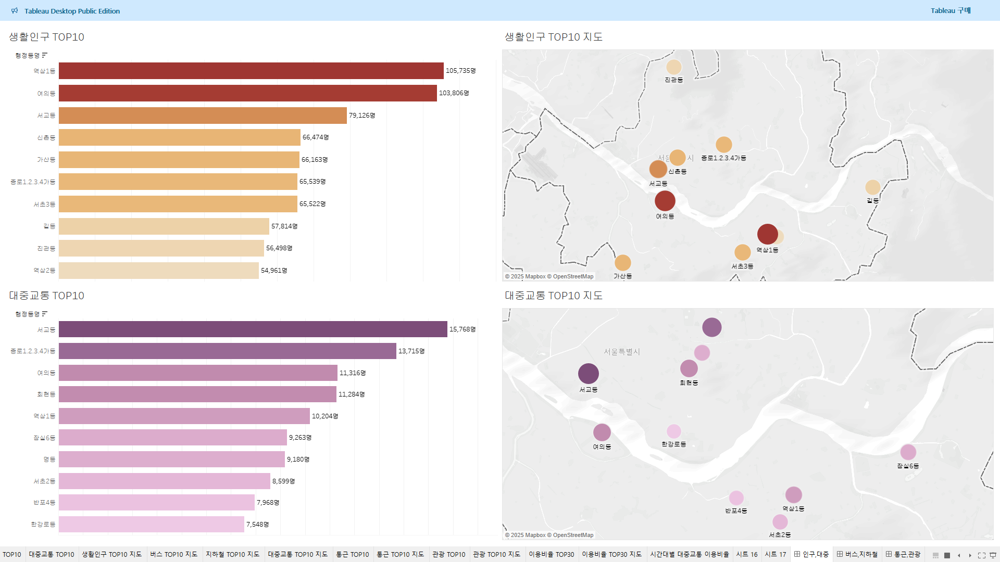

- 버스 이용자 수, 지하철 이용자 수 TOP10

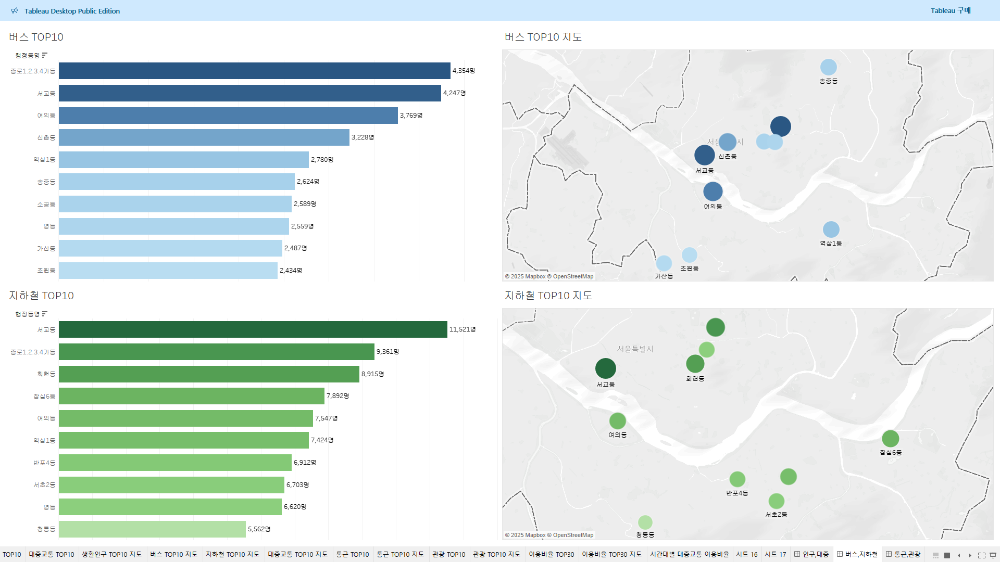

- 통근시간 (일년 / 7-9시, 18-20시), 관광시간 (봄,가을 - 4,5,10,11월 / 10-17시) TOP 10

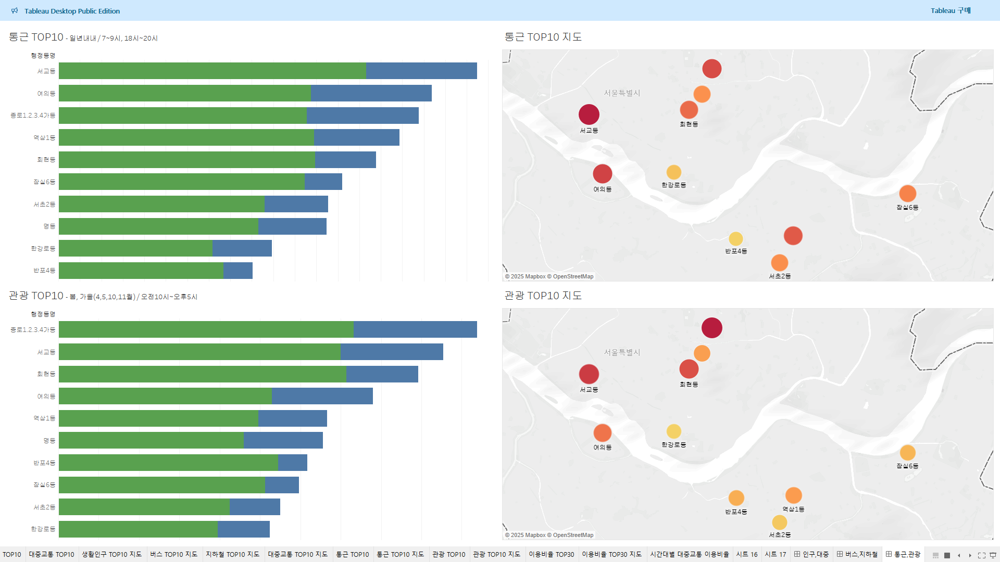

- 생활인구 대비 대중교통 이용률

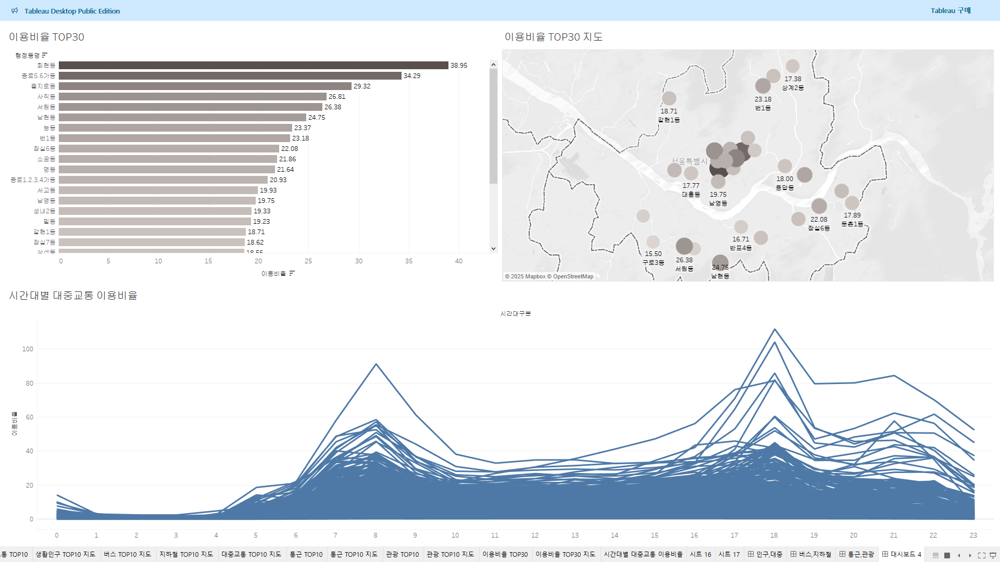

- **정리표**

| 순위 | 생활인구 TOP10 | 대중교통 TOP10 | 버스 TOP10 | 지하철 TOP10 | 통근시간 TOP10 | 관광시간 TOP10 | 이용비율 TOP10 |
|-----|-----|-----|-----|-----|-----|-----|-----|
| 1 | 역삼1동 | 서교동 | 종로1,2,3,4가동 | 서교동 | 서교동 | 종로1,2,3,4가동 | 회현동 |
| 2 | 여의동 | 종로1,2,3,4가동 | 서교동 | 종로1,2,3,4가동 | 여의동 | 서교동 | 종로5,6가동 |
| 3 | 서교동 | 여의동 | 여의동 | 회현동 | 종로1,2,3,4가동 | 회현동 | 을지로동 |
| 4 | 신촌동 | 회현동 | 신촌동 | 잠실6동 | 역삼1동 | 여의동 | 사직동 |
| 5 | 가산동 | 역삼1동 | 역삼1동 | 여의동 | 회현동 | 역삼1동 | 서원동 |
| 6 | 종로1,2,3,4가동 | 잠실6동 | 송중동 | 역삼1동 | 잠실6동 | 명동 | 남현동 |
| 7 | 서초3동 | 명동 | 소공동 | 반포4동 | 서초2동 | 반포4동 | 능동 |
| 8 | 길동 | 서초2동 | 명동 | 서초2동 | 명동 | 잠실6동 | 번1동 |
| 9 | 진관동 | 반포4동 | 가산동 | 명동 | 한강로동 | 서초2동 | 잠실6동 |
| 10 | 역삼2동 | 한강로동 | 조원동 | 청룡동 | 반포4동 | 한강로동 | 소공동 |

- 시간대별 대중교통 이용비율
    - 예상대로 출퇴근시간에 높음 (7-9 / 18-20)
    - 22시 언저리에 다시 높아지는 경향이 있음

### **한계**

1. 생각보다 일 단위/주 단위로 데이터를 처리할 일은 없음
    
    - 매일을 비교하는건 변수가 너무 많아서 그런듯.
    - 필터로 요일 / 시간대 구분을 두고 월 단위의 데이터를 분석하게 됐던 것 같음.

2. 데이터의 신뢰성
    
    - 중간에 데이터에서 중복된 값을 발견하여 원인을 찾았는데 예를 들어, 행정동코드가 11220인 값과 1122인 값이 있을때 에러를 최소한으로 발생시키기 위해 코드가 4자이면 뒤에 0을 추가하도록해서 11220이라는 값이 2개가 되게 되는데 원본 데이터에 왜 두가지 값이 있는지 알 수 없었음
    - 또한 같은 사이트에서 얻어 온 데이터가 동일한 기준으로 분류하고 있지 않았음

3. 데이터 간의 관계성

    - 시각화에만 집중하다 보니 놓치고 간 부분.
    - 데이터는 얻어냈으나, 그래서? 내가 무엇을 말하고자 하는가?
    - 다음엔 도출할 인사이트를 제대로 설정하고 원하는 데이터를 얻을 수 있는 쪽으로 전처리를 진행하도록 해야겠음.

4. 팀원과의 소통
    
    - 각자 다른 부분을 맡아 데이터를 처리하니까 내가 맡은 부분이 맞았는가? 에 대한 확신을 얻을 수 없음. 중첩되는 부분이 있었지만 다른 데이터로 다른 전처리를 수행했으므로 데이터를 신뢰할 수 없음. 다음 프로젝트에서는 같은 데이터로 다른 전처리를 수행하여 데이터를 얻어 신뢰도를 높이고자 함.

## 대체 교통 수단 - 최우진

### 태블로 시각화 링크
https://public.tableau.com/app/profile/woojin.choe5886/viz/_17404745458410/sheet0?publish=yes

### 공공자전거(따릉이) 이용패턴 분석

#### 공공자전거 이동경로 및 지하철역과의 거리

##### 데이터 전처리 및 가공

In [ ]:
# 자전거 시작-종료의 경도 위도 데이터
OD_data = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/따릉이_OD_운영_대여소_정보.csv")

# 필요한 컬럼 그룹화
OD_data = OD_data.groupby(['대여소_주소1_x', '시작대여소_위도', '시작대여소_경도', '대여소_주소1_y', '종료대여소_위도', '종료대여소_경도'])['전체건수'].sum().reset_index()

# 간편한 시각화를 위한 컬럼명 수정
OD_data.columns = ('시작대여소', '시작_위도', '시작_경도', '종료대여소', '종료_위도', '종료_경도', '이용건수')

# 이용건수를 기준으로 내림차순 정렬
OD_data = OD_data.sort_values(by='이용건수', ascending=False).reset_index(drop=True)

# 시작대여소 기준 그룹화
start_df = OD_data.groupby(['시작대여소', '시작_위도', '시작_경도'])['이용건수'].sum().reset_index()
start_df = start_df.sort_values(by='이용건수', ascending=False).reset_index(drop=True)
# 종료대여소 기준 그룹화
end_df = OD_data.groupby(['종료대여소', '종료_위도', '종료_경도'])['이용건수'].sum().reset_index()
end_df = end_df.sort_values(by='이용건수', ascending=False).reset_index(drop=True)

##### 데이터 시각화

In [ ]:
# 이용횟수 기준 top 100 위치 시각화

m = folium.Map(location=[37.5665, 126.9780], zoom_start=12, scrollWheelZoom=False, dragging=False)

# 전체 출발지-도착지를 선으로 연결
for _, row in OD_data.iterrows():
    folium.PolyLine(
        locations=[(row["시작_위도"], row["시작_경도"]), (row["종료_위도"], row["종료_경도"])],
        color="blue",
        weight=row["이용건수"] / 5,  # 이동 횟수에 따라 선 두께 설정
        opacity=0.7
    ).add_to(m)

# 출발지 기준 이용횟수 top 100
for _, row in start_df.head(100).iterrows():
    folium.CircleMarker(
        location=[row["시작_위도"], row["시작_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="red",  # 내부 색상
        fill_opacity=0.7,  # 투명도
    ).add_to(m)

# 도착지 기준 이용횟수 top 100
for _, row in end_df.head(100).iterrows():
    folium.CircleMarker(
        location=[row["종료_위도"], row["종료_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="orange",  # 내부 색상
        fill_opacity=0.7,  # 투명도
    ).add_to(m)

# 맵 출력
m

+ `빨강` ==> 시작지점
+ `오렌지` ==> 종료지점

In [ ]:
# 이용횟수 기준 bottom 100 위치 시각화

m = folium.Map(location=[37.5665, 126.9780], zoom_start=12, scrollWheelZoom=False, dragging=False)

# 전체 출발지-도착지를 선으로 연결
for _, row in OD_data.iterrows():
    folium.PolyLine(
        locations=[(row["시작_위도"], row["시작_경도"]), (row["종료_위도"], row["종료_경도"])],
        color="blue",
        weight=row["이용건수"] / 5,  # 이동 횟수에 따라 선 두께 설정
        opacity=0.7
    ).add_to(m)

# 출발지 기준 이용횟수 bottom 100
for _, row in start_df.tail(100).iterrows():
    folium.CircleMarker(
        location=[row["시작_위도"], row["시작_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="red",  # 내부 색상
        fill_opacity=0.7,  # 투명도
    ).add_to(m)

# 도착지 기준 이용횟수 bottom 100
for _, row in end_df.tail(100).iterrows():
    folium.CircleMarker(
        location=[row["종료_위도"], row["종료_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="orange",  # 내부 색상
        fill_opacity=0.7,  # 투명도
    ).add_to(m)

# 맵 출력
m

In [ ]:
# 지하철 역기준 대여소 위치
subway_data = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/subway_bike_distance.csv")

# 지하철역과 출발 및 도착 위치 기준 이용횟수 top 50

m = folium.Map(location=[37.5665, 126.9780], zoom_start=12, scrollWheelZoom=False, dragging=False)

for _, row in start_df.head(100).iterrows():
    folium.CircleMarker(
        location=[row["시작_위도"], row["시작_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="red",  # 내부 색상
        fill_opacity=0.7,  # 투명도 (0 = 완전 투명, 1 = 불투명)
    ).add_to(m)

for _, row in end_df.head(100).iterrows():
    folium.CircleMarker(
        location=[row["종료_위도"], row["종료_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="orange",  # 내부 색상
        fill_opacity=0.7,  # 투명도 (0 = 완전 투명, 1 = 불투명)
    ).add_to(m)

HeatMap(subway_data[["지하철 위도", "지하철 경도"]],
    blur=1,  # 흐림 효과
).add_to(m)

# 지도 저장 및 출력
# m.save("Flow_Map_Folium.html")
m

In [ ]:
# 지하철역과 출발 및 도착 위치 기준 이용횟수 bottom 50

m = folium.Map(location=[37.5665, 126.9780], zoom_start=12, scrollWheelZoom=False, dragging=False)

for _, row in start_df.tail(100).iterrows():
    folium.CircleMarker(
        location=[row["시작_위도"], row["시작_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="red",  # 내부 색상
        fill_opacity=0.7,  # 투명도 (0 = 완전 투명, 1 = 불투명)
    ).add_to(m)

for _, row in end_df.tail(100).iterrows():
    folium.CircleMarker(
        location=[row["종료_위도"], row["종료_경도"]],
        radius=10,  # 마커 크기
        color="black",  # 테두리 색상
        fill=True,
        fill_color="orange",  # 내부 색상
        fill_opacity=0.7,  # 투명도 (0 = 완전 투명, 1 = 불투명)
    ).add_to(m)

HeatMap(subway_data[["지하철 위도", "지하철 경도"]],
    blur=1,  # 흐림 효과
).add_to(m)

# 지도 저장 및 출력
# m.save("Flow_Map_Folium.html")
m

##### `자전거 대여 및 반납, 이동거리시각화 지하철분포 종합 분석`

- 대여 및 반남이 높은 지역
    - 자전거 이동 패턴을 분석한 결과, 주요 이동 경로가 도심 중심부 및 한강을 따라 집중되며, 특정 대여소 간의 반복적인 이동이 발생하고 있음.
    - 대여 및 반납이 가장 활발한 지점은 강남, 홍대, 여의도, 신촌, 구로디지털단지역 인근으로 나타남
    - 위 지역은 출퇴근시간대 충분히 영향을 받울 수 있는 지역으로 자전거 대여 후 대중교통을 이용하거나 반납 후 이동할 가능성이 높음
    - 히트맵을 통해 확인한 지하철 분포에서는 지하철역 밀집 지역과 자전거 대여·반납 지점이 상당부분 겹치며, 자전거가 지하철과 연계된 이동 수단으로 활용될 가능성이 충분함
    - 대여가 많은 지역과 반납이 많은 지역 간 균형을 맞추는 것을 고려해 볼만함

- 대여 및 반남이 낮은 지역
    - 대여소의 위치가 도심보다는 외곽 지역에 집중되며, 자전거 이동 경로도 길게 형성되지 않음
    - 히트맵에서 확인되는 지하철역 분포를 통해 분석한 결과, 지하철역과의 접근성이 낮거나, 대중교통 이용과의 연계성이 부족한 곳이 있을 수 있음
    - 또한 대중교통 이용객이 많은 지역에서도 자전거 대여가 활성화되지 않은 곳이 있어 이용 환경 개선이 필요함.
    - 출퇴근시간대 유동 인구가 많은 지역과 비교했을 때, 대여·반납이 낮은 지역은 상업지역이나 업무지구가 적고, 자전거도로와 같은 인프라가 미흡함
    - 자전거 이용 활성화를 위해, 대여소를 재배치 및 대중교통과의 연계성을 높이는 전략이 필요하며, 특히 낮은 이용 지역에 대한 추가적인 원인 분석이 중요함.

#### 공공자전거(따릉이)와 대중교통 연계성 분석

##### 버스 및 지하철 승객수가 자전거 이용에 미치는 영향
##### 데이터 전처리 및 가공

In [ ]:
# 자전거, 지하철, 버스 일별 승객수 데이터
bike_daily_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/따릉이_일별_이용정보(2024년).csv")
subway_daily_df = pd.read_csv('/content/drive/MyDrive/코드잇_데이터분석_6기/data/지하철_역별_승하차_총승객수(2024년).csv')
bus_daily_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/월별_버스_승하차_승객수.csv")

# 자전거 데이터 가공
bike_daily_df['대여일자'] = pd.to_datetime(bike_daily_df['대여일자'])  # 대여일자 날짜형으로 변황
bike_daily_df['사용일자'] = pd.to_datetime(bike_daily_df['대여일자']).dt.strftime("%Y%m%d") # 컬럼명 '사용일자'로 통일
bike_daily_df = bike_daily_df.groupby('사용일자')['이용건수'].sum().reset_index()  # 필요 컬럼만 추출
bike_daily_df.rename(columns={'이용건수':'자전거_이용건수'}, inplace=True)

# 지하철 데이터 가공
subway_daily_df['사용일자'] = subway_daily_df['사용일자'].astype(str)  # 병합을 위해 사용일자를 문자형으로 변환
subway_daily_df = subway_daily_df.groupby('사용일자')[['승차총승객수', '하차총승객수']].sum().reset_index()  # 필요한 컬럼만 추출
subway_daily_df.rename(columns={'승차총승객수':'지하철_승차승객수', '하차총승객수':'지하철_하차승객수'}, inplace=True)

# 버스 데이터 가공
bus_daily_df['사용일자'] = bus_daily_df['사용일자'].astype(str)  # 병합을 위해 사용일자를 문자형으로 변환
bus_daily_df = bus_daily_df.groupby('사용일자')[['승차총승객수', '하차총승객수']].sum().reset_index()  # 필요한 컬럼만 추출
bus_daily_df.rename(columns={'승차총승객수':'버스_승차승객수', '하차총승객수':'버스_하차승객수'}, inplace=True)  # 구분을 위해 컬럼명 수정

# 데이터셋 병합
bike_bus_sub_count = pd.merge(bike_daily_df, subway_daily_df, on='사용일자', how='left')
bike_bus_sub_count = pd.merge(bike_bus_sub_count, bus_daily_df, on='사용일자', how='left')

##### 데이터 시각화

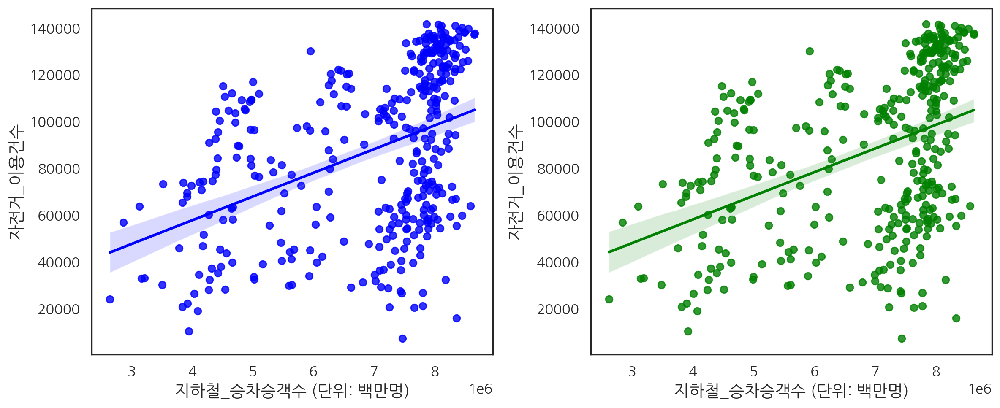

In [ ]:
# 지하철 승∙하차 승객수에 따른 자전거 이용건수 변화비교
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# 승차기준
sns.regplot(data=bike_bus_sub_count, x='지하철_승차승객수', y='자전거_이용건수', ax=ax[0], color='blue')
ax[0].set_xlabel("승차승객수 (단위: 백만명)")
ax[0].set_xlabel('지하철_승차승객수 (단위: 백만명)')

# 하차기준
sns.regplot(data=bike_bus_sub_count, x='지하철_하차승객수', y='자전거_이용건수', ax=ax[1], color='green')
ax[1].set_xlabel("하차승객수 (단위: 백만명)")
ax[1].set_xlabel('지하철_승차승객수 (단위: 백만명)')

plt.rc('font', family='AppleGothic')
plt.tight_layout()
plt.show()

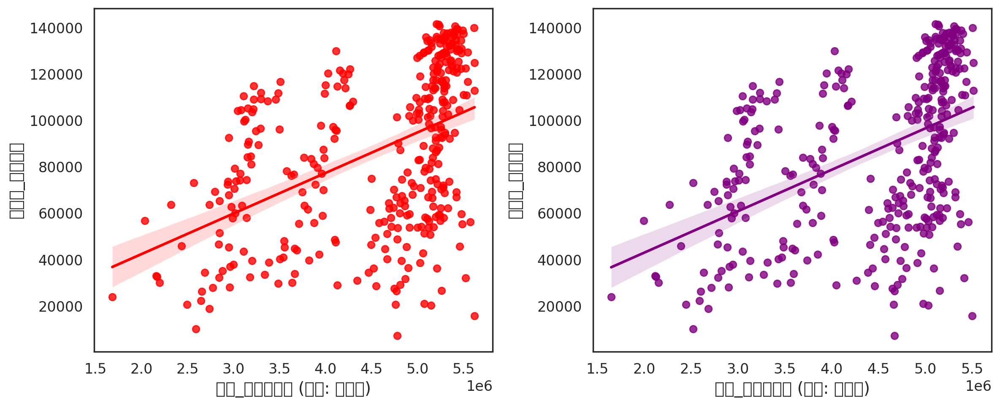

In [ ]:
# 지하철 승∙하차 승객수에 따른 자전거 이용건수 변화비교
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# 승차기준
sns.regplot(data=bike_bus_sub_count, x='버스_승차승객수', y='자전거_이용건수', ax=ax[0], color='red')
ax[0].set_xlabel("승차승객수 (단위: 백만명)")
ax[0].set_xlabel('버스_승차승객수 (단위: 백만명)')

# 하차기준
sns.regplot(data=bike_bus_sub_count, x='버스_하차승객수', y='자전거_이용건수', ax=ax[1], color='purple')
ax[1].set_xlabel("하차승객수 (단위: 백만명)")
ax[1].set_xlabel('버스_하차승객수 (단위: 백만명)')

plt.rc('font', family='Nanum Gothic')
plt.tight_layout()
plt.show()

##### 지하철역 기준 대여소와의 거리가 자전거 이용에 미치는 영향
##### 데이터 전처리 및 가공

In [ ]:
# 지하철 위도 경도 데이터
subway_bike_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/subway_bike_distance.csv")

# 자전거 이용횟수 데이터
bike_count_df = pd.read_csv("/content/drive/MyDrive/코드잇_데이터분석_6기/data/bike_count.csv")

# 각 데이터별 필요한 컬럼 추출
selected_columns_subway_bike = ['가장 가까운 따릉이 대여소', '따릉이 위도', '따릉이 경도', '거리 (m)', '거리 분류']
subway_bike_df = subway_bike_df[selected_columns_subway_bike]
selected_columns_bike_count = ['시작대여소_위도', '시작대여소_경도', '전체건수']
bike_count_df = bike_count_df[selected_columns_bike_count]

# 병합을 위해 컬럼명 수정
subway_bike_df.columns = ['대여소', '위도', '경도', '거리(m)', '거리_분류']
bike_count_df.columns = ('위도', '경도', '이용건수')

# 데이터 병합
merge_distance_df = pd.merge(subway_bike_df, bike_count_df, on='위도', how='inner')

# 단위 변환
merge_distance_df['거리(km)'] = merge_distance_df['거리(m)'] / 1000

# 거리기준 내림차순 정렬
merge_distance_df.sort_values(by='거리(km)', inplace=True)
merge_distance_df = merge_distance_df.reset_index(drop=True)

# 시각화를 위한 범위 설정
nearby_df = merge_distance_df.query('`거리_분류` == "가까움 (300m 이하)"')

nearby_df

,대여소,위도,경도_x,거리(m),거리_분류,경도_y,이용건수,거리(km)
0,서울특별시 강서구 양천로 22,37.57247,126.80617,8.10649,가까움 (300m 이하),126.80617,10,0.00811
1,서울특별시 성북구 정릉로 272,37.60310,127.01350,10.38338,가까움 (300m 이하),127.01350,2,0.01038
2,서울특별시 중랑구 용마산로 지하 227,37.57359,127.08682,10.64698,가까움 (300m 이하),127.08682,4,0.01065
3,서울특별시 구로구 경인로67길 160,37.51424,126.88287,10.72532,가까움 (300m 이하),127.12307,6,0.01073
4,서울특별시 구로구 경인로67길 160,37.51424,126.88287,10.72532,가까움 (300m 이하),126.88287,24,0.01073
...,...,...,...,...,...,...,...,...
306,서울특별시 송파구 올림픽로 8,37.51043,127.07137,216.34429,가까움 (300m 이하),127.07137,12,0.21634
307,서울특별시 중구 중구 한강대로 405,37.55541,126.96942,241.80833,가까움 (300m 이하),126.96942,20,0.24181
308,서울특별시 강남구 강남대로 지하 396,37.49847,127.03011,253.78910,가까움 (300m 이하),127.03011,12,0.25379
309,서울특별시 강서구 방화동 886-15,37.56155,126.80708,264.10983,가까움 (300m 이하),126.80708,4,0.26411


##### 데이터 시각화

In [ ]:
fig = px.scatter(data_frame=nearby_df, x='거리(m)', y='이용건수', marginal_x='histogram', marginal_y='rug')

fig.update_layout(width=800, height=600)

fig.show()

##### 공공자전거(따릉이) 이용패턴 가설검정

##### `가설1`: 지하철 승객이용수가 이용건수에 영향을 미칠 것이다.

In [ ]:
# 지하철 승차 승객수와 자전거 이용건수 상관분석
get_on_sub, p_value = pearsonr(bike_bus_sub_count['자전거_이용건수'], bike_bus_sub_count['지하철_승차승객수'])

# 지하철 승차 승객수와 자전거 이용건수 상관분석
get_off_sub, p_value = pearsonr(bike_bus_sub_count['자전거_이용건수'], bike_bus_sub_count['지하철_하차승객수'])


# ANOVA
f_stat, p_value = f_oneway(bike_bus_sub_count['지하철_승차승객수'], bike_bus_sub_count['지하철_하차승객수'], bike_bus_sub_count['자전거_이용건수'])

print("지하철 승차 승객수와 자전거 이용건수 상관분석 결과")
print(f"pearson_num: {get_on_sub:.4f}\np_value: {p_value}")
print()

print("지하철 하차 승객수와 자전거 이용건수 상관분석 결과")
print(f"pearson_num: {get_off_sub:.4f}\np_value: {p_value}")
print()

print("지하철 승하차 승객수와 자전거 이용건수 분석결과")
print(f"f_score: {f_stat:.4f}\np_value: {p_value}")

지하철 승차 승객수와 자전거 이용건수 상관분석 결과
pearson_num: 0.4233
p_value: 0.0

지하철 하차 승객수와 자전거 이용건수 상관분석 결과
pearson_num: 0.4226
p_value: 0.0

지하철 승하차 승객수와 자전거 이용건수 분석결과
f_score: 3949.9930
p_value: 0.0


##### `가설2`: 버스 승객이용수가 이용건수에 영향을 미칠 것이다.

In [ ]:
# 버스 승차 승객수와 자전거 이용건수 상관분석
get_on_bus, p_value = pearsonr(bike_bus_sub_count['자전거_이용건수'], bike_bus_sub_count['버스_승차승객수'])

# 버스 승차 승객수와 자전거 이용건수 상관분석
get_off_bus, p_value = pearsonr(bike_bus_sub_count['자전거_이용건수'], bike_bus_sub_count['버스_하차승객수'])


# ANOVA
f_stat, p_value = f_oneway(bike_bus_sub_count['버스_승차승객수'], bike_bus_sub_count['버스_하차승객수'], bike_bus_sub_count['자전거_이용건수'])

print("버스 승차 승객수와 자전거 이용건수 상관분석 결과")
print(f"pearson_num: {get_on_bus:.4f}\np_value: {p_value}")
print()

print("버스 하차 승객수와 자전거 이용건수 상관분석 결과")
print(f"pearson_num: {get_off_bus:.4f}\np_value: {p_value}")
print()

print("버스 승하차 승객수와 자전거 이용건수 분석결과")
print(f"f_score: {f_stat:.4f}\np_value: {p_value}")

버스 승차 승객수와 자전거 이용건수 상관분석 결과
pearson_num: 0.4641
p_value: 0.0

버스 하차 승객수와 자전거 이용건수 상관분석 결과
pearson_num: 0.4656
p_value: 0.0

버스 승하차 승객수와 자전거 이용건수 분석결과
f_score: 4223.8284
p_value: 0.0


##### `가설3`: 지하철 역과의 거리가 이용건수에 영향을 미칠 것이다.

In [ ]:
t_stat, p_value = stats.ttest_ind(merge_distance_df['거리(m)'], merge_distance_df['이용건수'])

print(f"t_socre: {t_stat:.4f}\np_value: {p_value:.4f}")

t_socre: 9.0723
p_value: 0.0000


 `통계적 가설검정 결과 종합 분석`

- 가설1: 지하철 승객이용수가 이용건수에 영향을 미칠 것이다.
    - 지하철 승차 승객수와 자전거 이용건수 상관분석 결과
        - pearson_num: 0.4233 ==> 양의 상관관계, 지하철 승차 승객수가 많아질 수록 자전거의 이용량이 높아짐
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

    - 지하철 하차 승객수와 자전거 이용건수 상관분석 결과
        - pearson_num: 0.4226 ==> 양의 상관관계, 지하철 하차 승객수가 많아질 수록 자전거의 이용량이 높아짐
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

    - 지하철 승하차 승객수와 자전거 이용건수 분석결과
        - f_score: 3949.9930 ==> 세 그룹간의 차이가 매우 크게 나타남
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

- 가설2: 버스 승객이용수가 이용건수에 영향을 미칠 것이다.
    - 버스 승차 승객수와 자전거 이용건수 상관분석 결과
        - pearson_num: 0.4641 ==> 양의 상관관계, 버스 승차 승객수가 많아질 수록 자전거의 이용량이 높아짐
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

    - 버스 하차 승객수와 자전거 이용건수 상관분석 결과
        - pearson_num: 0.4656 ==> 양의 상관관계, 버스 하차 승객수가 많아질 수록 자전거의 이용량이 높아짐
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

    - 버스 승하차 승객수와 자전거 이용건수 분석결과
        - f_score: 4223.8284 ==> 세 그룹간의 차이가 매우 크게 나타남
        - p_value: 0.0 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

- 가설3: 지하철 역과의 거리가 이용건수에 영향을 미칠 것이다.
    - t_socre: 9.0723 ==> 두 그룹간 차이가 있음
    - p_value: 0.0000 ==> p_value < 0.05 이므로 귀무가설 강하게 기각

##### `승객수 및 지하철역과 대여소의 거리가 대여건수에 미치는 영향 종합 분석`
- 승객수
    - 지하철 승차객수가 증가할수록 따릉이 이용건수도 증가하는 경향을 보이며, 대중교통과 자전거 이용간의 연계성이 높음
    - 자전거 이용량이 많은 지역일수록 지하철 이용객 수도 많아, 따릉이가 지하철과의 환승 수단으로 활용될 가능성이 높음
    
- 거리
    - 가까운거리(50m 이내)에서 이용 빈도가 높고, 거리가 증가할수록 이용 건수가 감소하는 패턴이 나타남
    - 50m 이하가 가장 많고, 100m를 넘어서면서 이용 빈도가 급격히 줄어드는 경향을 보임.
    - 대중교통과의 환승용, 단거리 이동 수단으로 활용되며, 이용 거리와 접근성이 중요한 요소로 작용함.

### 버스/지하철 혼잡도 및 이용패턴 분석

#### 버스 및 지하철 혼잡시간대 분석
##### 데이터 전처리 및 가공

In [ ]:
# 월별 시간대별 승객수 데이터
bus_passengers_df = pd.read_csv('/content/drive/MyDrive/코드잇_데이터분석_6기/data/시간대별_버스_승하차_승객수(2024년).csv')

# 컬럼명 변경
bus_passengers_df.rename(columns={"00시승차총승객수": '0시승차총승객수', "00시하차총승객수": '0시하차총승객수'}, inplace=True)

# 시간대별 승∙하차 고객 분류
start_time_columns = [f"{i}시승차총승객수" for i in range(24)]
end_time_columns = [f"{i}시하차총승객수" for i in range(24)]

# 그룹화
start_bus_df = bus_passengers_df.groupby('사용년월')[start_time_columns].sum().reset_index()
end_bus_df = bus_passengers_df.groupby('사용년월')[end_time_columns].sum().reset_index()

In [ ]:
# 월별 총승∙하차 고객수
bus_passengers_df['총승차고객수'] = bus_passengers_df[start_time_columns].sum(axis=1)
bus_passengers_df['총하차고객수'] = bus_passengers_df[end_time_columns].sum(axis=1)

# 데이터 그룹화
total_passengers = bus_passengers_df.groupby(['사용년월', '역명'])[['총승차고객수', '총하차고객수']].sum().reset_index()

##### 데이터 시각화

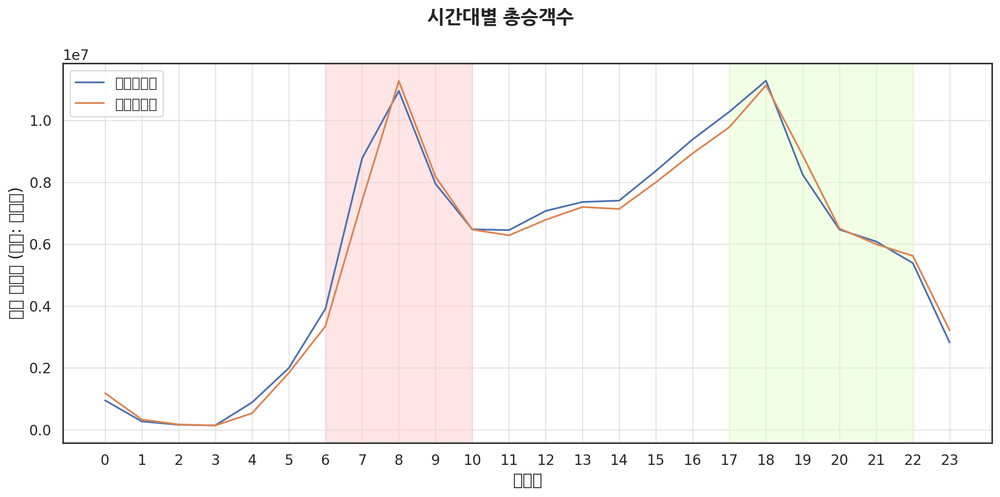

In [ ]:
# 시간대별 총승∙하차 고객수

# 시간대별 고객수 평균 값 계산
start_average_passengers = start_bus_df.iloc[:, 1:].mean().reset_index()
end_average_passengers = end_bus_df.iloc[:, 1:].mean().reset_index()

# 컬럼명 수정
start_average_passengers.rename(columns={0:'start_count'}, inplace=True)
end_average_passengers.rename(columns={0:'end_count'}, inplace=True)

# 데이터 병합
start_average_passengers["index"] = start_average_passengers["index"].str.replace("승차총승객수", "")
end_average_passengers["index"] = end_average_passengers["index"].str.replace("하차총승객수", "")

bus_merge_passengers_df = pd.merge(start_average_passengers, end_average_passengers, on='index', how='left')


sns.lineplot(data=bus_merge_passengers_df, x='index', y='start_count', label='승차승객수')
sns.lineplot(data=bus_merge_passengers_df, x='index', y='end_count', label='하차승객수')
plt.xticks(ticks=np.arange(0, 24, 1), labels=[f"{i}" for i in np.arange(0, 24, 1)])
plt.xlabel("시간대")
plt.ylabel("평균 승객수 (단위: 백만명)")
plt.grid(alpha=0.5)
plt.axvspan(6, 10, color='#FFCCCC', alpha=0.5)
plt.axvspan(17, 22, color='#E5FFCC', alpha=0.5)

plt.rc('font', family='NanumGothic')
plt.suptitle("시간대별 총승객수", fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

In [ ]:
# 일별 상위 20 정류장 승객수 평균
total_passengers["역명"] = total_passengers["역명"].str.replace(r"\(\d+\)$", "", regex=True)  # 역명 통일을 위해 뒷괄호 부분 재거

# 승∙하차 평균 승객수 계산 및 그룹화
total_group = total_passengers.groupby('역명')[['총승차고객수', '총하차고객수']].sum().reset_index()
total_group['총승객수평균'] = ((total_group['총승차고객수'] + total_group['총하차고객수']) / 2).astype(int)
total_group.sort_values(by='총승객수평균', ascending=False, inplace=True)
total_group

,역명,총승차고객수,총하차고객수,총승객수평균
8305,홍대입구역,7633590,6189366,6911478
745,고속터미널,6926803,6113046,6519924
2997,미아사거리역,6384494,5698197,6041345
1023,구로디지털단지역,6020126,5958463,5989294
4892,수유역.강북구청,5699694,5701775,5700734
...,...,...,...,...
2316,동작대교남단(가상),3,1,2
5711,여의교(가상),0,3,1
4060,서교동사거리,1,0,0
483,개봉교,1,0,0


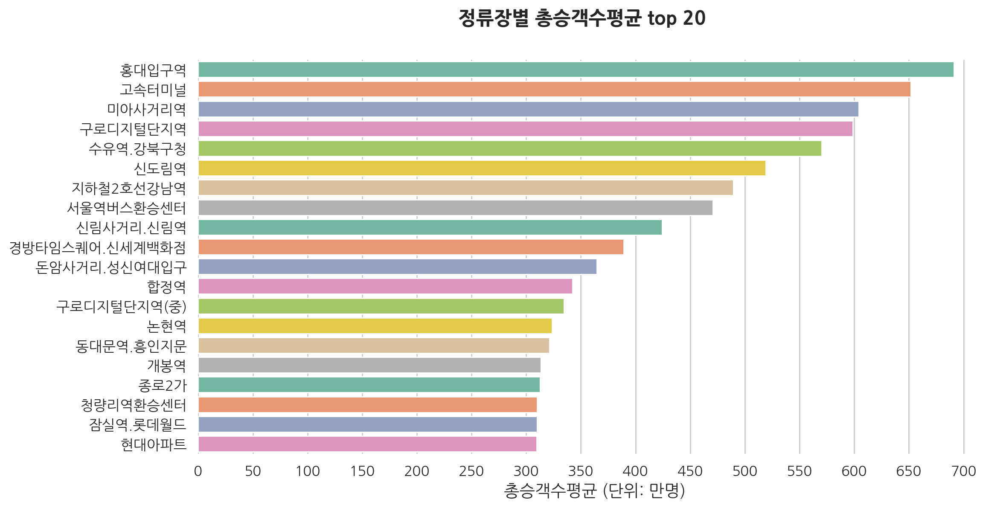

In [ ]:
fig, ax = plt.subplots(figsize=(12, 6))

sns.barplot(data=total_group.head(20), x='총승객수평균', y='역명', orient="y", ax=ax, palette='Set2')

ax.set_xlabel("총승객수평균 (단위: 만명)")
ax.set_ylabel("")
ax.set_xticks(ticks=np.arange(0, 7000001, 500000), labels=[f'{i}' for i in np.arange(0, 7000001, 500000)])
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))

plt.suptitle("정류장별 총승객수평균 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.grid(axis='x')
plt.show()


In [ ]:
# 출근시간대 승∙하차 승객수 그룹화
start_to_work = bus_passengers_df.groupby(['역명'])[['6시승차총승객수', '7시승차총승객수', '8시승차총승객수', '9시승차총승객수']].sum().reset_index()
end_to_work = bus_passengers_df.groupby(['역명'])[['6시하차총승객수', '7시하차총승객수', '8시하차총승객수', '9시하차총승객수']].sum().reset_index()

# 총승객수 계산
start_to_work['출근시간대_총승차승객수'] = start_to_work[['6시승차총승객수', '7시승차총승객수', '8시승차총승객수', '9시승차총승객수']].sum(axis=1)
end_to_work['출근시간대_총하차승객수'] = end_to_work[['6시하차총승객수', '7시하차총승객수', '8시하차총승객수', '9시하차총승객수']].sum(axis=1)

# 역명 통일
start_to_work['역명'] = start_to_work["역명"].str.replace(r"\(\d+\)$", "", regex=True)
end_to_work['역명'] = end_to_work["역명"].str.replace(r"\(\d+\)$", "", regex=True)

# 컬럼 정리
start_to_work.drop(columns=['6시승차총승객수', '7시승차총승객수', '8시승차총승객수', '9시승차총승객수'], inplace=True)
end_to_work.drop(columns=['6시하차총승객수', '7시하차총승객수', '8시하차총승객수', '9시하차총승객수'], inplace=True)

# 역명기준 총승객수 그룹화
start_to_work = start_to_work.groupby('역명')['출근시간대_총승차승객수'].sum().reset_index()
end_to_work = end_to_work.groupby('역명')['출근시간대_총하차승객수'].sum().reset_index()

# 승객수별 내림차순 정렬
start_to_work.sort_values(by='출근시간대_총승차승객수', ascending=False, inplace=True)
end_to_work.sort_values(by='출근시간대_총하차승객수', ascending=False, inplace=True)

# 인덱스 정렬
start_to_work.reset_index(drop=True, inplace=True)
end_to_work.reset_index(drop=True, inplace=True)

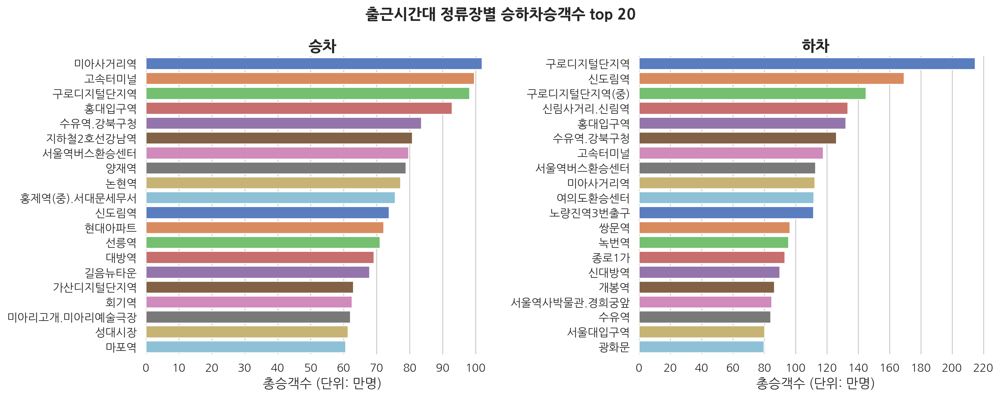

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

sns.barplot(data=start_to_work.head(20), x='출근시간대_총승차승객수', y='역명', orient="y", palette='muted', ax=ax[0])
ax[0].set_title("승차")
ax[0].set_xlabel("총승객수 (단위: 만명)")
ax[0].set_ylabel("")
ax[0].set_xticks(ticks=np.arange(0, 1000001, 100000), labels=[f'{i}' for i in np.arange(0, 1000001, 100000)])
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[0].grid(axis='x')


sns.barplot(data=end_to_work.head(20), x='출근시간대_총하차승객수', y='역명', orient="y", palette='muted', ax=ax[1])
ax[1].set_title("하차")
ax[1].set_xlabel("총승객수 (단위: 만명)")
ax[1].set_ylabel("")
ax[1].set_xticks(ticks=np.arange(0, 2200001, 200000), labels=[f'{i}' for i in np.arange(0, 2200001, 200000)])
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[1].grid(axis='x')

plt.suptitle("출근시간대 정류장별 승하차승객수 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

In [ ]:
# 퇴근시간대 승∙하차 승객수 그룹화
start_leave_work = bus_passengers_df.groupby(['역명'])[['17시승차총승객수', '18시승차총승객수', '19시승차총승객수', '20시승차총승객수', '21시승차총승객수']].sum().reset_index()
end_leave_work = bus_passengers_df.groupby(['역명'])[['17시하차총승객수', '18시하차총승객수', '19시하차총승객수', '20시하차총승객수', '21시하차총승객수']].sum().reset_index()

# 총승객수 계산
start_leave_work['퇴근시간대_총승차승객수'] = start_leave_work[['17시승차총승객수', '18시승차총승객수', '19시승차총승객수', '20시승차총승객수', '21시승차총승객수']].sum(axis=1)
end_leave_work['퇴근시간대_총하차승객수'] = end_leave_work[['17시하차총승객수', '18시하차총승객수', '19시하차총승객수', '20시하차총승객수', '21시하차총승객수']].sum(axis=1)

# 역명 통일
start_leave_work['역명'] = start_leave_work["역명"].str.replace(r"\(\d+\)$", "", regex=True)
end_leave_work['역명'] = end_leave_work["역명"].str.replace(r"\(\d+\)$", "", regex=True)

# 컬럼 정리
start_leave_work.drop(columns=['17시승차총승객수', '18시승차총승객수', '19시승차총승객수', '20시승차총승객수', '21시승차총승객수'], inplace=True)
end_leave_work.drop(columns=['17시하차총승객수', '18시하차총승객수', '19시하차총승객수', '20시하차총승객수', '21시하차총승객수'], inplace=True)

# 역명기준 총승객수 그룹화
start_leave_work = start_leave_work.groupby('역명')['퇴근시간대_총승차승객수'].sum().reset_index()
end_leave_work = end_leave_work.groupby('역명')['퇴근시간대_총하차승객수'].sum().reset_index()

# 승객수별 내림차순 정렬
start_leave_work.sort_values(by='퇴근시간대_총승차승객수', ascending=False, inplace=True)
end_leave_work.sort_values(by='퇴근시간대_총하차승객수', ascending=False, inplace=True)

# 인덱스 정렬
start_leave_work.reset_index(drop=True, inplace=True)
end_leave_work.reset_index(drop=True, inplace=True)

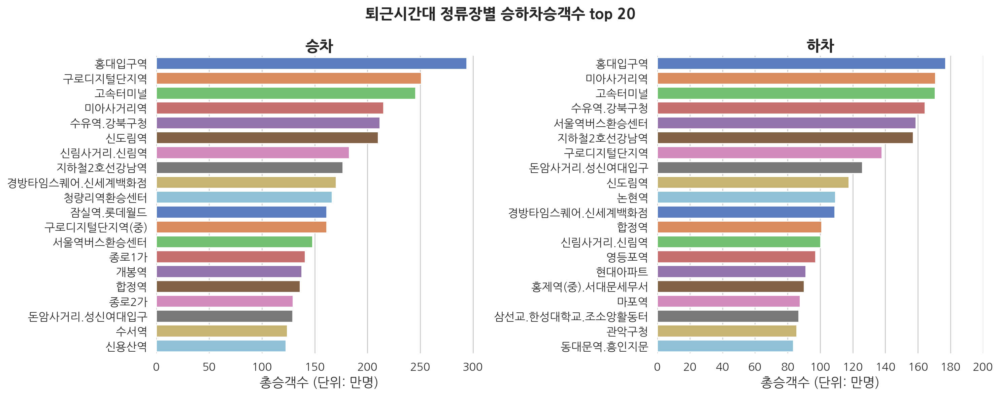

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

sns.barplot(data=start_leave_work.head(20), x='퇴근시간대_총승차승객수', y='역명', orient="y", palette='muted', ax=ax[0])
ax[0].set_title("승차")
ax[0].set_xlabel("총승객수 (단위: 만명)")
ax[0].set_ylabel("")
ax[0].set_xticks(ticks=np.arange(0, 3000001, 500000), labels=[f'{i}' for i in np.arange(0, 3000001, 500000)])
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[0].grid(axis='x')


sns.barplot(data=end_leave_work.head(20), x='퇴근시간대_총하차승객수', y='역명', orient="y", palette='muted', ax=ax[1])
ax[1].set_title("하차")
ax[1].set_xlabel("총승객수 (단위: 만명)")
ax[1].set_ylabel("")
ax[1].set_xticks(ticks=np.arange(0, 2000001, 200000), labels=[f'{i}' for i in np.arange(0, 2000001, 200000)])
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[1].grid(axis='x')


plt.suptitle("퇴근시간대 정류장별 승하차승객수 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

In [ ]:
# 퇴근시간대 승∙하차 승객수 그룹화
start_night_df = bus_passengers_df.groupby(['역명'])[['0시승차총승객수', '1시승차총승객수', '2시승차총승객수', '3시승차총승객수', '4시승차총승객수', '5시승차총승객수']].sum().reset_index()
end_night_df = bus_passengers_df.groupby(['역명'])[['0시하차총승객수', '1시하차총승객수', '2시하차총승객수', '3시하차총승객수', '4시하차총승객수', '5시하차총승객수']].sum().reset_index()

# 총승객수 계산
start_night_df['심야시간대_총승차승객수'] = start_night_df[['0시승차총승객수', '1시승차총승객수', '2시승차총승객수', '3시승차총승객수', '4시승차총승객수', '5시승차총승객수']].sum(axis=1)
end_night_df['심야시간대_총하차승객수'] = end_night_df[['0시하차총승객수', '1시하차총승객수', '2시하차총승객수', '3시하차총승객수', '4시하차총승객수', '5시하차총승객수']].sum(axis=1)

# 역명 통일
start_night_df['역명'] = start_night_df["역명"].str.replace(r"\(\d+\)$", "", regex=True)
end_night_df['역명'] = end_night_df["역명"].str.replace(r"\(\d+\)$", "", regex=True)

# 컬럼 정리
start_night_df.drop(columns=['0시승차총승객수', '1시승차총승객수', '2시승차총승객수', '3시승차총승객수', '4시승차총승객수', '5시승차총승객수'], inplace=True)
end_night_df.drop(columns=['0시하차총승객수', '1시하차총승객수', '2시하차총승객수', '3시하차총승객수', '4시하차총승객수', '5시하차총승객수'], inplace=True)

# 역명기준 총승객수 그룹화
start_night_df = start_night_df.groupby('역명')['심야시간대_총승차승객수'].sum().reset_index()
end_night_df = end_night_df.groupby('역명')['심야시간대_총하차승객수'].sum().reset_index()

# 승객수별 내림차순 정렬
start_night_df.sort_values(by='심야시간대_총승차승객수', ascending=False, inplace=True)
end_night_df.sort_values(by='심야시간대_총하차승객수', ascending=False, inplace=True)

# 인덱스 정렬
start_night_df.reset_index(drop=True, inplace=True)
end_night_df.reset_index(drop=True, inplace=True)

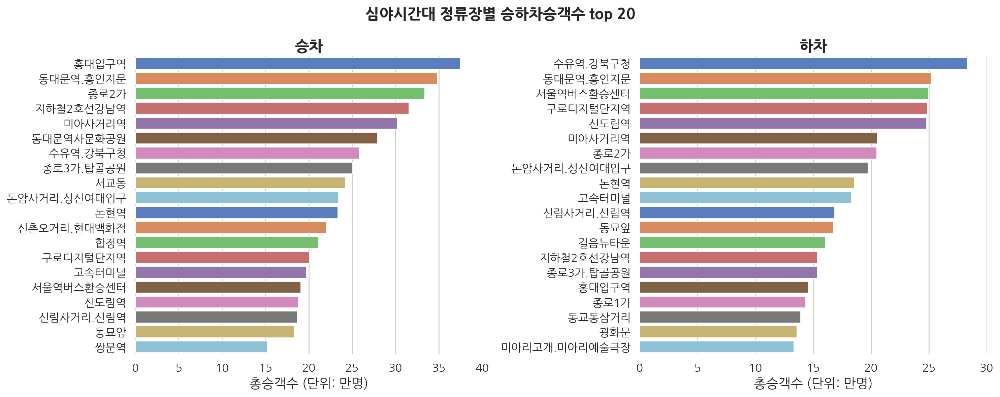

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

sns.barplot(data=start_night_df.head(20), x='심야시간대_총승차승객수', y='역명', orient="y", palette='muted', ax=ax[0])
ax[0].set_title("승차")
ax[0].set_xlabel("총승객수 (단위: 만명)")
ax[0].set_ylabel("")
ax[0].set_xticks(ticks=np.arange(0, 400001, 50000), labels=[f'{i}' for i in np.arange(0, 400001, 50000)])
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[0].grid(axis='x')


sns.barplot(data=end_night_df.head(20), x='심야시간대_총하차승객수', y='역명', orient="y", palette='muted', ax=ax[1])
ax[1].set_title("하차")
ax[1].set_xlabel("총승객수 (단위: 만명)")
ax[1].set_ylabel("")
ax[1].set_xticks(ticks=np.arange(0, 300001, 50000), labels=[f'{i}' for i in np.arange(0, 300001, 50000)])
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[1].grid(axis='x')


plt.suptitle("심야시간대 정류장별 승하차승객수 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

##### 지하철 이용량 분석

In [ ]:
# 월별 시간대별 승객수 데이터
subway_passengers_df = pd.read_csv('/content/drive/MyDrive/코드잇_데이터분석_6기/data/시간대별_지하철_승하차_승객수(2024년).csv', encoding='euc-kr')

# 필요한 연도의 월만 추출
subway_passengers_df = subway_passengers_df[(subway_passengers_df['사용월'] >= 202401) & (subway_passengers_df['사용월'] <= 202412)].sort_values(by='사용월').reset_index(drop=True)

# 시간대별 승∙하차 고객 분류
start_time_columns = [f"{i:02d}시-{i+1:02d}시 승차인원" for i in range(24)]
end_time_columns = [f"{i:02d}시-{i+1:02d}시 하차인원" for i in range(24)]

# 그룹화
start_subway_df = subway_passengers_df.groupby('사용월')[start_time_columns].sum().reset_index()
end_subway_df = subway_passengers_df.groupby('사용월')[end_time_columns].sum().reset_index()

In [ ]:
# 월별 총승∙하차 고객수
subway_passengers_df['총승차고객수'] = subway_passengers_df[start_time_columns].sum(axis=1)
subway_passengers_df['총하차고객수'] = subway_passengers_df[end_time_columns].sum(axis=1)

# 데이터 그룹화
total_sub_passengers = subway_passengers_df.groupby(['사용월', '지하철역'])[['총승차고객수', '총하차고객수']].sum().reset_index()

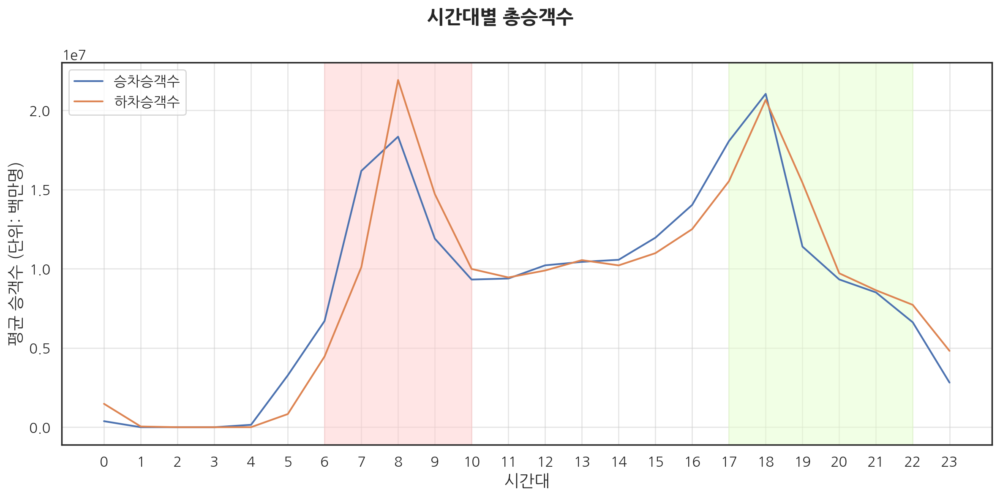

In [ ]:
# 시간대별 총승∙하차 고객수

# 시간대별 고객수 평균 값 계산
start_sub_passengers = start_subway_df.iloc[:, 1:].mean().reset_index()
end_sub_passengers = end_subway_df.iloc[:, 1:].mean().reset_index()

# 컬럼명 수정
start_sub_passengers.rename(columns={0:'start_count'}, inplace=True)
end_sub_passengers.rename(columns={0:'end_count'}, inplace=True)

# 데이터 병합
start_sub_passengers["index"] = start_sub_passengers["index"].str.replace("시 승차인원", "")
end_sub_passengers["index"] = end_sub_passengers["index"].str.replace("시 하차인원", "")

merge_sub_df = pd.merge(start_sub_passengers, end_sub_passengers, on='index', how='outer')


sns.lineplot(data=merge_sub_df, x='index', y='start_count', label='승차승객수')
sns.lineplot(data=merge_sub_df, x='index', y='end_count', label='하차승객수')
plt.xticks(ticks=np.arange(0, 24, 1), labels=[f"{i}" for i in np.arange(0, 24, 1)])
plt.xlabel("시간대")
plt.ylabel("평균 승객수 (단위: 백만명)")
plt.grid(alpha=0.5)
plt.axvspan(6, 10, color='#FFCCCC', alpha=0.5)
plt.axvspan(17, 22, color='#E5FFCC', alpha=0.5)

plt.suptitle("시간대별 총승객수", fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

In [ ]:
# 상위 20 지하철역 승객수 평균

# 승∙하차 평균 승객수 계산 및 그룹화
total_sub_group = total_sub_passengers.groupby('지하철역')[['총승차고객수', '총하차고객수']].sum().reset_index()
total_sub_group['총승객수평균'] = ((total_sub_group['총승차고객수'] + total_sub_group['총하차고객수']) / 2).astype(int)
total_sub_group.sort_values(by='총승객수평균', ascending=False, inplace=True)

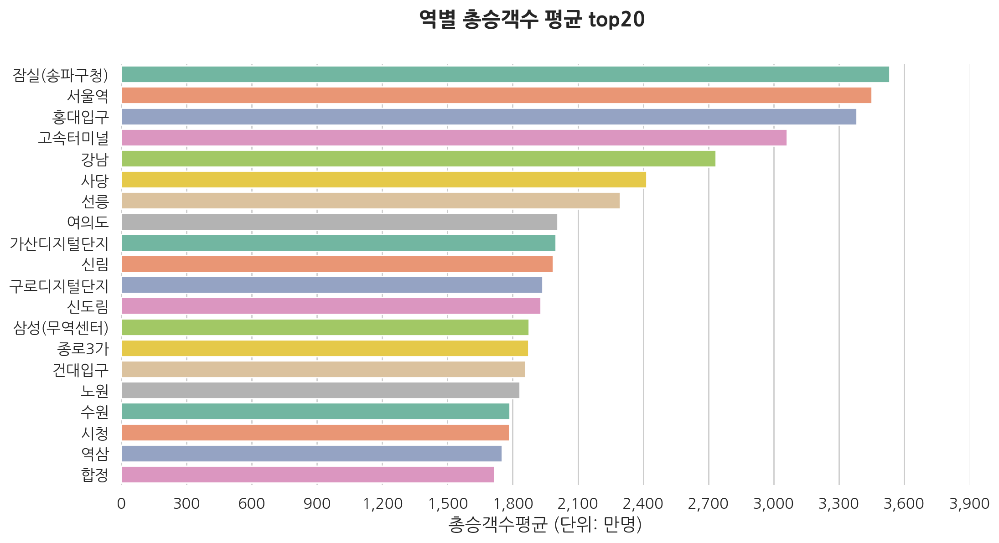

In [ ]:
fig, ax = plt.subplots(figsize=(12, 6))

sns.barplot(data=total_sub_group.head(20), x='총승객수평균', y='지하철역', orient="y", ax=ax, palette='Set2')

ax.set_xlabel("총승객수평균 (단위: 만명)")
ax.set_ylabel("")
ax.set_xticks(ticks=np.arange(0, 40000001, 3000000), labels=[f'{i}' for i in np.arange(0, 40000001, 3000000)])
ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000):,}'))

plt.suptitle("역별 총승객수 평균 top20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.grid(axis='x')
plt.show()


- 완전히 같은 역: 고속터미널, 신도림, 합정
- 거의 같은 역 (지명 차이만 있음): 홍대입구(역), 구로디지털단지(역), 신림(사거리.신림역), 강남(지하철2호선강남역), 서울역(버스환승센터), 잠실(롯데월드)

In [ ]:
# 출근시간대 승∙하차 승객수 그룹화
sub_start_to_work = subway_passengers_df.groupby(['지하철역'])[['06시-07시 승차인원', '07시-08시 승차인원', '08시-09시 승차인원', '09시-10시 승차인원']].sum().reset_index()
sub_end_to_work = subway_passengers_df.groupby(['지하철역'])[['06시-07시 하차인원', '07시-08시 하차인원', '08시-09시 하차인원', '09시-10시 하차인원']].sum().reset_index()

# 총승객수 계산
sub_start_to_work['출근시간대_총승차승객수'] = sub_start_to_work[['06시-07시 승차인원', '07시-08시 승차인원', '08시-09시 승차인원', '09시-10시 승차인원']].sum(axis=1)
sub_end_to_work['출근시간대_총하차승객수'] = sub_end_to_work[['06시-07시 하차인원', '07시-08시 하차인원', '08시-09시 하차인원', '09시-10시 하차인원']].sum(axis=1)

# 역명 통일
sub_start_to_work['지하철역'] = sub_start_to_work["지하철역"].str.replace(r"\(\d+\)$", "", regex=True)
sub_end_to_work['지하철역'] = sub_end_to_work["지하철역"].str.replace(r"\(\d+\)$", "", regex=True)

# 컬럼 정리
sub_start_to_work.drop(columns=['06시-07시 승차인원', '07시-08시 승차인원', '08시-09시 승차인원', '09시-10시 승차인원'], inplace=True)
sub_end_to_work.drop(columns=['06시-07시 하차인원', '07시-08시 하차인원', '08시-09시 하차인원', '09시-10시 하차인원'], inplace=True)

# 역명기준 총승객수 그룹화
sub_start_to_work = sub_start_to_work.groupby('지하철역')['출근시간대_총승차승객수'].sum().reset_index()
sub_end_to_work = sub_end_to_work.groupby('지하철역')['출근시간대_총하차승객수'].sum().reset_index()

# 승객수별 내림차순 정렬
sub_start_to_work.sort_values(by='출근시간대_총승차승객수', ascending=False, inplace=True)
sub_end_to_work.sort_values(by='출근시간대_총하차승객수', ascending=False, inplace=True)

# 인덱스 정렬
sub_start_to_work.reset_index(drop=True, inplace=True)
sub_end_to_work.reset_index(drop=True, inplace=True)

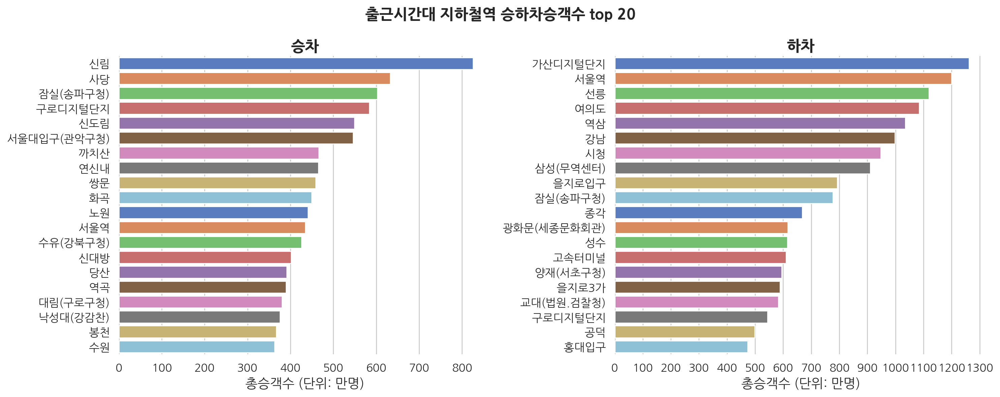

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

sns.barplot(data=sub_start_to_work.head(20), x='출근시간대_총승차승객수', y='지하철역', orient="y", palette='muted', ax=ax[0])
ax[0].set_title("승차")
ax[0].set_xlabel("총승객수 (단위: 만명)")
ax[0].set_ylabel("")
ax[0].set_xticks(ticks=np.arange(0, 8500001, 1000000), labels=[f'{i}' for i in np.arange(0, 8500001, 1000000)])
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[0].grid(axis='x')


sns.barplot(data=sub_end_to_work.head(20), x='출근시간대_총하차승객수', y='지하철역', orient="y", palette='muted', ax=ax[1])
ax[1].set_title("하차")
ax[1].set_xlabel("총승객수 (단위: 만명)")
ax[1].set_ylabel("")
ax[1].set_xticks(ticks=np.arange(0, 13000001, 1000000), labels=[f'{i}' for i in np.arange(0, 13000001, 1000000)])
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[1].grid(axis='x')

plt.suptitle("출근시간대 지하철역 승하차승객수 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

In [ ]:
# 출근시간대 승∙하차 승객수 그룹화
sub_start_leave_work = subway_passengers_df.groupby(['지하철역'])[['17시-18시 승차인원', '18시-19시 승차인원', '19시-20시 승차인원', '20시-21시 승차인원', '21시-22시 승차인원']].sum().reset_index()
sub_end_leave_work = subway_passengers_df.groupby(['지하철역'])[['17시-18시 하차인원', '18시-19시 하차인원', '19시-20시 하차인원', '20시-21시 하차인원', '21시-22시 하차인원']].sum().reset_index()

# 총승객수 계산
sub_start_leave_work['퇴근시간대_총승차승객수'] = sub_start_leave_work[['17시-18시 승차인원', '18시-19시 승차인원', '19시-20시 승차인원', '20시-21시 승차인원', '21시-22시 승차인원']].sum(axis=1)
sub_end_leave_work['퇴근시간대_총하차승객수'] = sub_end_leave_work[['17시-18시 하차인원', '18시-19시 하차인원', '19시-20시 하차인원', '20시-21시 하차인원', '21시-22시 하차인원']].sum(axis=1)

# 역명 통일
sub_start_leave_work['지하철역'] = sub_start_leave_work["지하철역"].str.replace(r"\(\d+\)$", "", regex=True)
sub_end_leave_work['지하철역'] = sub_end_leave_work["지하철역"].str.replace(r"\(\d+\)$", "", regex=True)

# 컬럼 정리
sub_start_leave_work.drop(columns=['17시-18시 승차인원', '18시-19시 승차인원', '19시-20시 승차인원', '20시-21시 승차인원', '21시-22시 승차인원'], inplace=True)
sub_end_leave_work.drop(columns=['17시-18시 하차인원', '18시-19시 하차인원', '19시-20시 하차인원', '20시-21시 하차인원', '21시-22시 하차인원'], inplace=True)

# 역명기준 총승객수 그룹화
sub_start_leave_work = sub_start_leave_work.groupby('지하철역')['퇴근시간대_총승차승객수'].sum().reset_index()
sub_end_leave_work = sub_end_leave_work.groupby('지하철역')['퇴근시간대_총하차승객수'].sum().reset_index()

# 승객수별 내림차순 정렬
sub_start_leave_work.sort_values(by='퇴근시간대_총승차승객수', ascending=False, inplace=True)
sub_end_leave_work.sort_values(by='퇴근시간대_총하차승객수', ascending=False, inplace=True)

# 인덱스 정렬
sub_start_leave_work.reset_index(drop=True, inplace=True)
sub_end_leave_work.reset_index(drop=True, inplace=True)

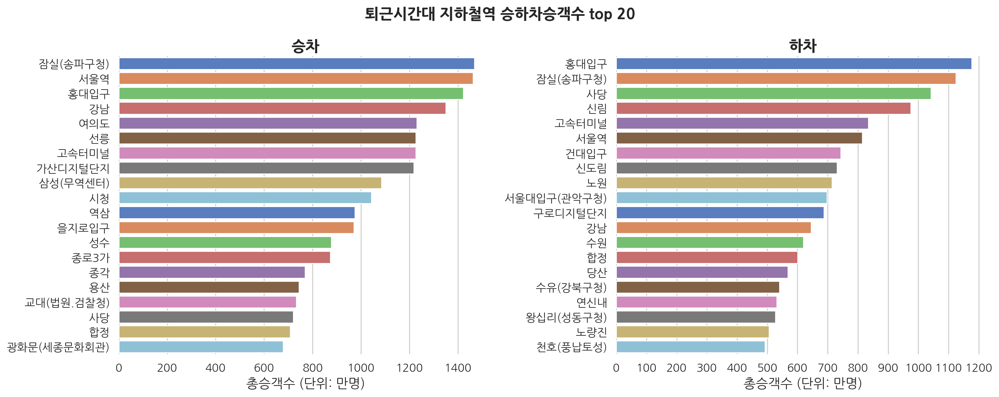

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 6))

sns.barplot(data=sub_start_leave_work.head(20), x='퇴근시간대_총승차승객수', y='지하철역', orient="y", palette='muted', ax=ax[0])
ax[0].set_title("승차")
ax[0].set_xlabel("총승객수 (단위: 만명)")
ax[0].set_ylabel("")
ax[0].set_xticks(ticks=np.arange(0, 15000001, 2000000), labels=[f'{i}' for i in np.arange(0, 15000001, 2000000)])
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[0].grid(axis='x')


sns.barplot(data=sub_end_leave_work.head(20), x='퇴근시간대_총하차승객수', y='지하철역', orient="y", palette='muted', ax=ax[1])
ax[1].set_title("하차")
ax[1].set_xlabel("총승객수 (단위: 만명)")
ax[1].set_ylabel("")
ax[1].set_xticks(ticks=np.arange(0, 12000001, 1000000), labels=[f'{i}' for i in np.arange(0, 12000001, 1000000)])
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x/10000)}'))
ax[1].grid(axis='x')

plt.suptitle("퇴근시간대 지하철역 승하차승객수 top 20", fontsize=16, fontweight='bold')
sns.despine(left=True, bottom=True)
plt.tight_layout()
plt.show()

##### `버스 및 지하철 혼잡도 종합분석`
- 버스
    - 출퇴근
        - 홍대입구, 고속터미널, 미아사거리, 구로디지털단지 등에서 대중교통 이용객이 많아 주요 환승 거점으로 작용함
        - 정류장별 총 승객 수를 보면, 환승센터 및 주요 역세권이 대중교통 이용의 중심지 역할을 하고 있음.
        - 출근시간대에는 미아사거리, 고속터미널, 구로디지털단지에서 승차가 많고, 신도림, 구로디지털단지에서 하차가 많음
        - 퇴근시간대에는 홍대입구, 구로디지털단지, 고속터미널, 미아사거리에서 승·하차가 많음
        - 대중교통 이용량과 자전거 이용량의 연계성을 고려할 때, 출퇴근 시간대 및 주요 환승 거점 주변에 자전거 대여소를 추가 배치할 필요가 있음
    - 심야
        - 승차승객수가가 가장 많은 지역은 홍대입구, 동대문, 종로2가 순으로 나타났으며, 이는 유흥·쇼핑·관광객이 많은 지역이므로 늦은 시간까지 이동이 활발함을 보여줌    
        - 하차승객수가 가장 많은 지역은 수유, 동대문, 서울역, 구로디지털단지 순으로 나타났으며, 이는 주거 지역으로 돌아가는 이동 패턴을 반영하며, 강북 및 강서쪽으로 이동이 집중됨
        - 고속터미널, 신도림, 사당 등 일부 지역은 하차 수요가 높아 서울 외곽으로 심야 시간대 대중교통을 이용하여 귀가하는 패턴을 보임


- 지하철
    - 이용객수
        - 역별 총승객수평균은 잠실(송파구청), 서울역, 홍대입구, 고속터미널, 강남 등에서 가장 높게 나타남.

    - 시간대
        - 출근시간대에는 신림, 사당, 잠실(송파구청), 구로디지털단지역에서 승차가 많고, 가산디지털단지, 서울역, 선릉, 여의도에서 하차가 많음
        - 퇴근시간대에는 잠실(송파구청), 서울역, 홍대입구, 강남, 여의도에서 승차가 많고, 홍대입구, 잠실(송파구청), 사당, 신림, 고속터미널에서 하차가 많음.

### 분석결과 및 한계

#### 자전거 이용량에 영향을 미치는 변수들로 회귀분석 진행

In [ ]:
# 변수 데이터셋 병합
bike_bus_sub_count.rename(columns={'사용일자':'대여일자'} ,inplace=True)
bike_bus_sub_count['대여일자'] = pd.to_datetime(bike_bus_sub_count['대여일자'])
merge_df = pd.merge(bike_bus_sub_count, weather_df, on='대여일자', how='left')
merge_df = pd.merge(bike_df, merge_df, on='대여일자', how='left')

# 필요한 컬럼만 그룹화
merge_df = merge_df.groupby('대여일자')[['자전거_이용건수', '지하철_승차승객수', '지하철_하차승객수', '버스_승차승객수', '버스_하차승객수', '강수량(mm)', '평균기온(℃)']].mean().reset_index()

# 표준화할 변수 선택
features = ['자전거_이용건수', '지하철_승차승객수', '지하철_하차승객수', '버스_승차승객수', '버스_하차승객수', '강수량(mm)', '평균기온(℃)']

# StandardScaler 적용
scaler = StandardScaler()
merge_df[features] = scaler.fit_transform(merge_df[features])

# 결측치 처리
merge_df.dropna(inplace=True)

# 변수 설정
X = merge_df[['지하철_승차승객수', '지하철_하차승객수', '버스_승차승객수', '버스_하차승객수', '강수량(mm)', '평균기온(℃)']]
y = merge_df[['자전거_이용건수']]

# 데이터 분리
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30)

In [ ]:
# 2차 다항식 생성
polynomial_transformer = PolynomialFeatures(2)

# 자전거 이용건수에 영향을 미치는 컬럼들을 다항식으로 변환
polynomial_data = polynomial_transformer.fit_transform(merge_df[['지하철_승차승객수', '지하철_하차승객수', '버스_승차승객수', '버스_하차승객수', '강수량(mm)', '평균기온(℃)']])

# 변환된 데이터를 데이터프레임으로 변환
X = pd.DataFrame(polynomial_data, columns=polynomial_transformer.get_feature_names_out())

# 타겟 데이터
y = merge_df[['자전거_이용건수']]

# 데이터 분리
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

# 회귀모델 생성 및 학습
poly = LinearRegression()
poly.fit(X_train, y_train)

# 테스트 데이터 예측 수행
y_test_prediction = poly.predict(X_test)

# r2값과 평균 제곱근 오차 계산
r2 = r2_score(y_test, y_test_prediction)
rmse = mean_squared_error(y_test, y_test_prediction) ** 0.5

# 평균 제곱근 오차값과 r2값 출력
print(f"RMSE: {rmse}\nr2_Score: {r2}")

RMSE: 0.3830104102923195
r2_Score: 0.8325601406940399


In [ ]:
# X에 상수항 추가
X = sm.add_constant(X)

# 최소제곱법을 사용해서 회귀분석 진행
poly_api = sm.OLS(y, X).fit()

# 분석 결과 요약 출력
print(poly_api.summary())

                            OLS Regression Results                            
Dep. Variable:               자전거_이용건수   R-squared:                       0.885
Model:                            OLS   Adj. R-squared:                  0.876
Method:                 Least Squares   F-statistic:                     96.70
Date:                Mon, 24 Feb 2025   Prob (F-statistic):          1.54e-141
Time:                        09:08:17   Log-Likelihood:                -122.93
No. Observations:                 366   AIC:                             301.9
Df Residuals:                     338   BIC:                             411.1
Df Model:                          27                                         
Covariance Type:            nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
1                       0.1495    

# 인사이트

- 월요일부터 일요일이 될수록 버스, 지하철과 따릉이 이용객은 감소한다
- 강수량이 증가할때 따릉이 이용수가 감소한고, 비가 5mm이상으로 많이 올 시 지하철 이용 승객이 감소하는 경향이 있지만 체감할정도라고 보기에는 어렵다
- 눈이 많이 올수록 버스 승객은 증가하지만,  따릉이용객은 감소한다
- 온도가 높아질수록 버스와 따릉이 이용자수는 증가한다
- 월이 진행됨에 따라(1월에서 12월이 됨에따라) 버스이용자의 수가 증가하는 경향성을 보인다

- 대여 및 반납이 높은 곳은 지하철 역과의 거리가 가깝고,
- 강남, 여의도, 구로디지털단지등 상업지역이 밀집해 있어 출퇴근에 이용량이 집중하게 됨
- 또한 주거지와 상업지역간의 이동량이 많고 또한 주말에는 강남, 홍대, 한강주변과 같이 유흥/쇼핑/여가 활동등을 위한 고객들의 수요가 많음
- 반면 낮은 곳은 지하철역과의 거리가 멀고, 주거위주의 중심지역고, 상업시설들이 비교적 적음

# 개선 및 향후 방향 제시

- 강남, 홍대입구, 여의도, 구로디지털단지등 대여 및 반납의 이용객수가 많은 곳에 추가 대여소 설치 검토
- 주거지에서 상업지역으로의 이동량이 많으므로 균형을 유연하게 맞출 수 있게 조정
- 자전거의 이용률이 낮은지역에서의 할인 및 다양한 이벤트를 통해 이용 유도
- 버스와 지하철과의 연계성 강화를 위해 환승정책 도입
- 상업지역에 주로 위치하는 기업들과의 협력을 통해 출퇴근시 자전거 이용에 대한 지원프로그램 마련
- 중고등학생들에게 등하교시간에 무료로 이용할 수 있도록 하고, 대학교 및 공공기간들과의 협력을 통해 무료대여 지원

##기대효과


- 출퇴근 및 등하교 시간에 자전거 이용 증가로 대중교통 혼잡 완화
- 대여 및 반납 주요 밀집지역에 추가 대여소 설치로 이용에 차질 없이 운영
- 낮은 이용률을 보이는 곳에 자전거 도로망 확대 및 이벤트를 통해 이용률 증가
- 전체적인 자전거 이용률 상승으로 도시친화적인 이미지 생성